Zhao, T. Z., Kumar, V., Levine, S., & Finn, C. (2023). [Learning fine-grained bimanual manipulation with low-cost hardware](https://arxiv.org/abs/2304.13705). arXiv preprint arXiv:2304.13705.

<!-- Abstract—Fine manipulation tasks, such as threading cable ties or slotting a battery, are notoriously difficult for robots because they require precision, careful coordination of contact forces, and closed-loop visual feedback. Performing these tasks typically requires high-end robots, accurate sensors, or careful calibration, which can be expensive and difficult to set up. Can learning enable low-cost and imprecise hardware to perform these fine manipulation tasks? We present a low-cost system that performs end-to-end imitation learning directly from real demonstrations, collected with a custom teleoperation interface. Imitation learning, however, presents its own challenges, particularly in high-precision domains: errors in the policy can compound over time, and human demonstrations can be non-stationary. To address these challenges, we develop a simple yet novel algorithm, Action Chunking with Transformers (ACT), which learns a generative model over action sequences. ACT allows the robot to learn 6 difficult tasks in the real world, such as opening a translucent condiment cup and slotting a battery with 80-90% success, with only 10 minutes worth of demonstrations. Project website: tonyzhaozh.github.io/aloha -->
**摘要**
穿线扎带或插入电池等精细操作任务对于机器人来说极其困难, 因为它们需要接触力的精确、细致的协调和闭环视觉反馈。
执行这些任务通常需要高端机器人、精确的传感器或仔细的校准，这些昂贵且难以配置。
学习能否使低成本且不精确的硬件执行这些精细操作任务?
我们提出了一种低成本系统, 该系统直接从(通过自定义远程操作界面收集的)真实演示中执行端到端模仿学习。
然而, 模仿学习有其自身的挑战, 特别是在高精度领域: 策略中的误差会随着时间的推移而复合, 并且人类的演示是非平稳的。
为了应对这些挑战, 我们开发了一种简单而新颖的算法, Action Chunking with Transformers(ACT), 它学习动作序列的生成模型。
ACT 让机器人仅通过10分钟的演示就能学会现实世界中的6项高难度任务, 例如打开半透明的调味杯和插入电池, 成功率高达80-90%。项目网址: https://tonyzhaozh.github.io/aloha/

# INTRODUCTION
<!-- Fine manipulation tasks involve precise, closed-loop feed-back and require high degrees of hand-eye coordination to adjust and re-plan in response to changes in the environment. Examples of such manipulation tasks include opening the lid of a condiment cup or slotting a battery, which involve delicate operations such as pinching, prying, and tearing rather than broad-stroke motions such as picking and placing. Take opening the lid of a condiment cup in Figure 1 as an example, where the cup is initialized upright on the table: the right gripper needs to first tip it over, and nudge it into the opened left gripper. Then the left gripper closes gently and lifts the cup off the table. Next, one of the right fingers approaches the cup from below and pries the lid open. Each of these steps requires high precision, delicate hand-eye coordination, and rich contact. Millimeters of error would lead to task failure. -->
精细操作任务涉及精确的闭环反馈, 需要高度的手眼协调能力, 以便根据环境变化进行调整和重新规划。
此类操作任务的示例包括打开调味杯的盖子或插入电池, 这些操作涉及捏、撬和撕等精细操作, 而不是拾取和放置等大动作。
以[图1](#fig.1)中打开调味杯的盖子为例, 杯子被初始化为直立在桌子上: 右夹子需要先将它翻过来, 然后将其推入张开的左夹子中。
然后, 左夹子轻轻闭合并将杯子从桌子上抬起。
接下来, 右手指之一从下方接近杯子并撬开盖子。
每个步骤都需要高精度、精细的手眼协调和强接触。
毫米级误差都会导致任务失败。

<span id='fig.1'></span>
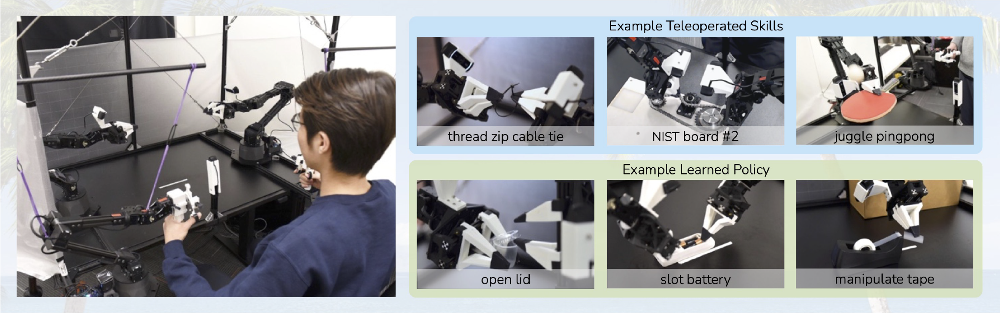
<!-- Fig. 1: ALOHA: A Low-cost Open-source Hardware System for Bimanual Teleoperation. The whole system costs <$20k with off-the-shelf robots and 3D printed components. Left: The user teleoperates by backdriving the leader robots, with the follower robots mirroring the motion. Right: ALOHA is capable of precise, contact-rich, and dynamic tasks. We show examples of both teleoperated and learned skills. -->
图1: ALOHA: 一种低成本的双手远程操作开源硬件系统。整个系统的成本不到 2 万美元, 包括现成的机器人和 3D 打印组件。左图: 用户通过反向驱动leader机器人进行远程操作, follower机器人映射其动作。右图: ALOHA 能够执行精确、接触性强且动态的任务。我们展示了远程操作和学习技能的示例。

<!-- Existing systems for fine manipulation use expensive robots and high-end sensors for precise state estimation [29, 60, 32, 41]. In this work, we seek to develop a low-cost system for fine manipulation that is, in contrast, accessible and reproducible. However, low-cost hardware is inevitably less precise than high-end platforms, making the sensing and planning challenge more pronounced. One promising direction to resolve this is to incorporate learning into the system. Humans also do not have industrial-grade proprioception [71], and yet we are able to perform delicate tasks by learning from closed-loop visual feedback and actively compensating for errors. In our system, we therefore train an end-to-end policy that directly maps RGB images from commodity web cameras to the actions. This pixel-to-action formulation is particularly suitable for fine manipulation, because fine manipulation often involves objects with complex physical properties, such that learning the manipulation policy is much simpler than modeling the whole environment. Take the condiment cup example: modeling the contact when nudging the cup, and also the deformation when prying open the lid involves complex physics on a large number of degrees of freedom. Designing a model accurate enough for planning would require significant research and task specific engineering efforts. In contrast, the policy of nudging and opening the cup is much simpler, since a closed-loop policy can react to different positions of the cup and lid rather than precisely anticipating how it will move in advance. -->
现有的精细操作系统使用昂贵的机器人和高端传感器, 用于精确的状态估计[29, 60, 32, 41]。
在这项工作中, 我们寻求开发一种低成本的精细操作系统, 相比之下, 该系统易上手且可重复。
然而, 低成本硬件不可避免地不如高端平台精确, 这使得感知和规划挑战更明显。
解决这个问题的一个有希望的方向是将学习融入系统。
人类也没有工业级的本体感觉 [71], 但我们能够(通过从闭环视觉反馈中学习并主动补偿误差)执行精细的任务。
因此, 在我们的系统中, 我们训练了一种端到端策略, 将(来自商品网络摄像头的) RGB 图像直接映射到动作。
这种像素到动作的公式化特别适合精细操作, 因为精细操作通常涉及具有复杂物理属性的对象, 因此学习操作策略比建模整个环境更简单。
以调味杯为例: 建模轻推杯子时的接触, 以及撬开盖子时的变形, 涉及大量自由度的复杂物理。
设计一个足够精确的规划模型需要大量研究和任务专用工程努力。
相反, 轻推和打开杯子的策略要简单得多, 因为闭环策略可以对杯子和盖子的不同位置做出响应, 而不是提前精确预测它将如何移动。

<!-- Training an end-to-end policy, however, presents its own challenges. The performance of the policy depends heavily on the training data distribution, and in the case of fine manipulation, high-quality human demonstrations can provide tremendous value by allowing the system to learn from human dexterity. We thus build a low-cost yet dexterous teleoperation system for data collection, and a novel imitation learning algorithm that learns effectively from the demonstrations. We overview each component in the following two paragraphs.  -->
然而, 训练端到端策略本身也存在挑战。
策略的性能在很大程度上取决于训练数据分布, 在精细操作的情况下, 高质量的人类演示可以(通过允许系统从人类的灵活性中学习)提供巨大的价值。
因此, 我们构建了一个低成本但灵巧的远程操作系统来收集数据, 以及一个(从演示中有效学习的)新型模仿学习算法。
我们在下面两段中概述每个组件。

<!-- **Teleoperation system**. We devise a teleoperation setup with two sets of low-cost, off-the-shelf robot arms. They are approximately scaled versions of each other, and we use joint-space mapping for teleoperation. We augment this setup with 3D printed components for easier backdriving, leading to a highly capable teleoperation system within a $20k budget. We showcase its capabilities in Figure 1, including teleoperation of precise tasks such as threading a zip tie, dynamic tasks such as juggling a ping pong ball, and contact-rich tasks such as assembling the chain in the NIST board #2 [4]. -->
**远程操作系统**。
我们设计了一个远程操作装置, 其中包含两个低成本、现成的机械臂。
它们是彼此的近似缩放版本, 我们使用关节空间映射, 用于远程操作。
我们用 3D 打印组件增强了这个装置, 以便于反向驱动, 从而在 2 万美元的预算内, 打造出一个功能强大的远程操作系统。
我们在[图1](#fig.1)中展示了它的能力, 包括精确任务的远程操作(例如穿扎带)、动态任务(例如玩乒乓球)以及接触性强的任务(例如在 NIST 板 #2 中组装链条)[4]。

<!-- **Imitation learning algorithm**. Tasks that require precision and visual feedback present a significant challenge for imitation learning, even with high-quality demonstrations. Small errors in the predicted action can incur large differences in the state, exacerbating the “compounding error” problem of imitation learning [47, 64, 29]. To tackle this, we take inspiration from action chunking, a concept in psychology that describes how sequences of actions are grouped together as a chunk, and executed as one unit [35]. In our case, the policy predicts the target joint positions for the next k timesteps, rather than just one step at a time. This reduces the effective horizon of the task by k-fold, mitigating compounding errors. Predicting action sequences also helps tackle temporally correlated confounders [61], such as pauses in demonstrations that are hard to model with Markovian single-step policies. To further improve the smoothness of the policy, we propose temporal ensembling, which queries the policy more frequently and averages across the overlapping action chunks. We implement action chunking policy with Transformers [65], an architecture designed for sequence modeling, and train it as a conditional VAE (CVAE) [55, 33] to capture the variability in human data. We name our method Action Chunking with Transformers (ACT), and find that it significantly outperforms previous imitation learning algorithms on a range of simulated and real-world fine manipulation tasks. -->
**模仿学习算法**。
需要精确度和视觉反馈的任务对模仿学习提出了一个重大挑战, 即使有高质量的演示。
预测动作中的很小误差会导致状态的巨大差异, 从而加剧模仿学习的“复合误差”问题 [47, 64, 29]。
为了解决这个问题, 我们从action chunking中汲取灵感，这是心理学中的一个概念，描述了如何将动作序列组合成一个块, 并作为一个单元执行 [35]。
在我们的案例中, 该策略预测接下来的 k 个时间步的目标关节位置, 而不是一次只预测一步。
这将任务的有效范围降低k折, 缓解了复合误差。
预测动作序列也有助于处理时间相关的混杂因素 [61], 例如(难以用马尔可夫单步策略建模的)演示中的暂停。
为了进一步提高策略的平滑度, 我们提出了 temporal ensembling, 它可以更频繁地查询策略, 并对重叠的动作块进行平均。
我们基于Transformers [65] (一种为序列建模而设计的架构)实现action chunking策略, 并将其训练为一个条件 VAE(CVAE)[55, 33], 以捕捉人类数据的变化性。
我们将我们的方法命名为 Action Chunking with Transformers (ACT), 并发现它在一系列模拟和现实世界的精细操作任务上, 明显优于以前的模仿学习算法。

<!-- The key contribution of this paper is a low-cost system for learning fine manipulation, comprising a teleoperation system and a novel imitation learning algorithm. The teleoperation system, despite its low cost, enables tasks with high precision and rich contacts. The imitation learning algorithm, Action Chunking with Transformers (ACT), is capable of learning precise, close-loop behavior and drastically outperforms previous methods. The synergy between these two parts allows learning of 6 fine manipulation skills directly in the real-world, such as opening a translucent condiment cup and slotting a battery with 80-90% success, from only 10 minutes or 50 demonstration trajectories. -->
本文的主要贡献是一个(用于学习精细操作的)低成本系统, 包括一个远程操作系统和一种新颖的模仿学习算法。
远程操作系统尽管成本低廉, 但可以实现高精度和强接触的任务。
模仿学习算法ACT, 能够学习精确的闭环行为, 并且远远优于以前的方法。
这两个部分的协同作用允许在现实世界中, 从仅仅10分钟或50条演示轨迹中, 直接学习6种精细操作技能, 例如打开半透明的调味杯和插入电池, 成功率达到 80-90%。

# RELATED WORK
<!-- **Imitation learning for robotic manipulation**. Imitation learning allows a robot to directly learn from experts. Behavioral cloning (BC) [44] is one of the simplest imitation learning algorithms, casting imitation as supervised learning from observations to actions. Many works have then sought to improve BC, for example by incorporating history with various architectures [39, 49, 26, 7], using a different training objective [17, 42], and including regularization [46]. Other works emphasize the multi-task or few-shot aspect of imitation learning [14, 25, 11], leveraging language [51, 52, 26, 7], or exploiting the specific task structure [43, 68, 28, 52]. Scaling these imitation learning algorithms with more data has led to impressive systems that can generalize to new objects, instructions, or scenes [15, 26, 7, 32]. In this work, we focus on building an imitation learning system that is low-cost yet capable of performing delicate, fine manipulation tasks. We tackle this from both hardware and software, by building a high-performance teleoperation system, and a novel imitation learning algorithm that drastically improves previous methods on fine manipulation tasks. -->
**机器人操作的模仿学习**。
模仿学习允许机器人直接向专家学习。
行为克隆(BC)[44]是最简单的模仿学习算法之一, 将模仿视为从观察到动作的监督学习。
随后, 许多研究试图改进 BC, 例如将历史与各种架构结合[39, 49, 26, 7], 使用不同的训练目标[17, 42], 并包含正则化[46]。
其他研究强调模仿学习的多任务或少样本方面[14, 25, 11], 利用语言[51, 52, 26, 7], 或利用特定的任务结构[43, 68, 28, 52]。
用更多数据扩展这些模仿学习算法已经产生了令人印象深刻的系统，可以泛化到新的对象、指令或场景[15, 26, 7, 32]。
在这项工作中, 我们专注于构建一个模仿学习系统, 该系统成本低, 但能够执行精细操作任务。
我们从硬件和软件两个方面处理这个问题, 通过构建高性能远程操控系统和新的模仿学习算法, 该算法在精细操作任务方面大幅改进了以前的方法。

<!-- **Addressing compounding errors**. A major shortcoming of BC is compounding errors, where errors from previous timesteps accumulate and cause the robot to drift off of its training distribution, leading to hard-to-recover states [47, 64]. This problem is particularly prominent in the fine manipulation setting [29]. One way to mitigate compounding errors is to allow additional on-policy interactions and expert corrections, such as DAgger [47] and its variants [30, 40, 24]. However, expert annotation can be time-consuming and unnatural with a teleoperation interface [29]. One could also inject noise at demonstration collection time to obtain datasets with corrective behavior [36], but for fine manipulation, such noise injection can directly lead to task failure, reducing the dexterity of teleoperation system. To circumvent these issues, previous works generate synthetic correction data in an offline manner [16, 29, 70]. While they are limited to settings where lowdimensional states are available, or a specific type of task like grasping. Due to these limitations, we need to address the compounding error problem from a different angle, compatible with high-dimensional visual observations. We propose to reduce the effective horizon of tasks through action chunking, i.e., predicting an action sequence instead of a single action, and then ensemble across overlapping action chunks to produce trajectories that are both accurate and smooth. -->
**解决复合误差**。
<font color="red">BC的一个主要缺点是复合误差</font>, 其中来自先前时间步的误差累积, 并引起机器人偏离其训练分布, 从而导致难以恢复的状态[47, 64]。
这个问题在精细操作配置中尤为突出[29]。
一种缓解复合误差的方法是允许额外的策略交互和专家校正, 例如DAgger[47]及其变体[30, 40, 24]。
然而, 使用远程操作界面进行专家标注会非常耗时且不自然[29]。
也可以在演示收集时注入噪声以获得具有纠正行为的数据集[36], 但对于精细操作, 这种噪声注入会直接导致任务失败, 从而降低远程操作系统的灵活性。
为了规避这些问题, 以前的工作(以离线方式)生成合成校正数据[16, 29, 70]。
而它们仅限于低维状态可用, 或抓取等特定类型任务的配置。
由于这些限制, 我们需要从不同的角度解决复合误差问题, 兼容高维视觉观察。
我们提出通过action chunking减少任务的有效范围, 即预测动作序列而不是单个动作, 然后对重叠动作块进行集成, 以产生既准确又平滑的轨迹。

<!-- **Bimanual manipulation**. Bimanual manipulation has a long history in robotics, and has gained popularity with the lowering of hardware costs. Early works tackle bimanual manipulation from a classical control perspective, with known environment dynamics [54, 48], but designing such models can be time-consuming, and they may not be accurate for objects with complex physical properties. More recently, learning has been incorporated into bimanual systems, such as reinforcement learning [9, 10], imitating human demonstrations [34, 37, 59, 67, 32], or learning to predict key points that chain together motor primitives [20, 19, 50]. Some of the works also focus on fine-grained manipulation tasks such as knot untying, cloth flattening, or even threading a needle [19, 18, 31], while using robots that are considerably more expensive, e.g. the da Vinci surgical robot or ABB YuMi. Our work turns to low-cost hardware, e.g. arms that cost around $5k each, and seeks to enable them to perform high-precision, closed-loop tasks. Our teleoperation setup is most similar to Kim et al. [32], which also uses joint-space mapping between the leader and follower robots. Unlike this previous system, we do not make use of special encoders, sensors, or machined components. We build our system with only off-the-shelf robots and a handful of 3D printed parts, allowing non-experts to assemble it in less than 2 hours. -->
**双手操作**。
双手操作在机器人领域有着悠久的历史, 随着硬件成本的降低越来越受欢迎。
早期的研究在已知环境动态下, 从经典控制角度处理双手操作[54, 48], 但设计此类模型会非常耗时, 并且对于具有复杂物理属性的物体, 它们可能不准确。
最近, learning已被纳入双手系统, 例如强化学习[9, 10]、模仿人类演示[34, 37, 59, 67, 32]或学习预测(将motor primitives链接在一起的)关键点[20, 19, 50]。
一些研究也关注细粒度的操作任务, 例如解结、布料展平, 甚至穿针引线[19, 18, 31], 同时使用相当昂贵的机器人, 例如达芬奇外科机器人或ABB YuMi。
我们的工作转向低成本硬件, 例如每只售价约5,000美元的机械臂, 并寻求使它们能够执行高精度、闭环任务。
我们的远程操作配置与Kim et al. [32]最相似, 他们也使用leader和follower机器人之间的关节空间映射。
与该系统不同, 我们不使用特殊编码器、传感器或机械加工的部件。
我们仅使用现成的机器人和少量3D打印部件, 构建我们的系统, 让非专家在2小时内组装它。

# ALOHA: A LOW-COST OPEN-SOURCE HARDWARE SYSTEM FOR BIMANUAL TELEOPERATION
<!-- We seek to develop an accessible and high-performance teleoperation system for fine manipulation. We summarize our design considerations into the following 5 principles.
1) **Low-cost**: The entire system should be within budget for most robotic labs, comparable to a single industrial arm.
2) **Versatile**: It can be applied to a wide range of fine manipulation tasks with real-world objects.
3) **User-friendly**: The system should be intuitive, reliable, and easy to use.
4) **Repairable**: The setup can be easily repaired by researchers, when it inevitably breaks.
5) **Easy-to-build**: It can be quickly assembled by researchers, with easy-to-source materials. -->
我们致力于开发一种易上手且性能卓越的远程操作系统, 用于精细操作。我们将设计考虑总结为以下 5 个原则。
1) **低成本**: 整个系统应在大多数机器人实验室的预算之内, 与单个工业手臂相当。
2) **多功能**: 可应用于针对真实世界对象的各种精细操作任务。
3) **用户友好**: 系统应直观、可靠且易于使用。
4) **可修复**: 当装置不可避免地发生故障时, 研究人员可以轻松修复它。
5) **易于搭建**: 研究人员可以(使用易于采购的材料)快速组装它。

<!-- When choosing the robot to use, principles 1, 4, and 5 lead us to build a bimanual parallel-jaw grippers setup with two ViperX 6-DoF robot arms [1, 66]. We do not employ dexterous hands due to price and maintenance considerations. The ViperX arm used has a working payload of 750g and 1.5m span, with an accuracy of 5-8mm. The robot is modular and simple to repair: in the case of motor failure, the low-cost Dynamixel motors can be easily replaced. The robot can be purchased off-the-shelf for around $5600. The OEM fingers, however, are not versatile enough to handle fine manipulation tasks. We thus design our own 3D printed “see-through” fingers and fit it with gripping tape (Fig 3). This allows for good visibility when performing delicate operations, and robust grip even with thin plastic films. -->
在选择要使用的机器人时, 原则 1、4 和 5 使我们构建一个双手平行夹持器装置, 带有两个 ViperX 6-DoF 机器人手臂 [1, 66]。
出于价格和维护方面的考虑, 我们不使用灵巧的手。
使用的 ViperX 手臂工作有效载荷为 750g, 跨度为 1.5m, 精度为 5-8mm。
该机器人是模块化的, 且易于维修: 在电机故障的情况下, 可以轻松更换低成本的 Dynamixel 电机。
该机器人可以直接购买, 约为 5600 美元。
然而, OEM 手指的通用行不足, 无法处理精细的操作任务。
因此, 我们设计了自己的 3D 打印“透明”手指, 并用抓握胶带固定它([图3](#fig.3))。
这样可以在执行精细操作时提供良好的可视性, 并且即使使用薄塑料薄膜时也能提供稳健地抓握。

<span id='fig.3'></span>
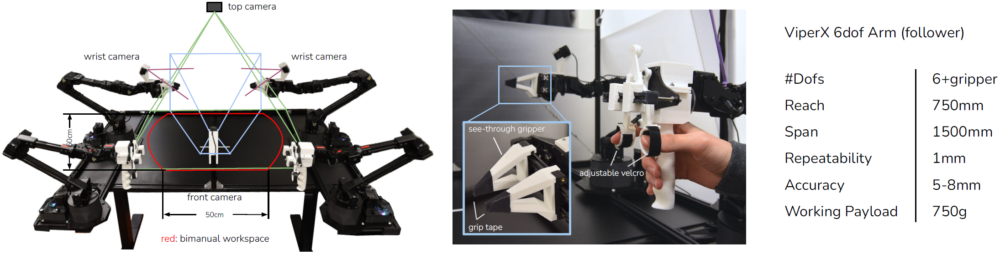
<!-- Fig. 3: Left: Camera viewpoints of the front, top, and two wrist cameras, together with an illustration of the bimanual workspace of ALOHA. Middle: Detailed view of the “handle and scissor” mechanism and custom grippers. Right: Technical spec of the ViperX 6dof robot [1]. -->
图3: 左图: 前部、顶部和两个腕部摄像头的camera viewpoints, 以及 ALOHA 双手工作空间的图示。中图: “手柄和剪刀”机构和定制夹持器的详细视图。右图: ViperX 6dof 机器人的技术规格 [1]。

<!-- We then seek to design a teleoperation system that is maximally user-friendly around the ViperX robot. Instead of mapping the hand pose captured by a VR controller or camera to the end-effector pose of the robot, i.e. task-space mapping, we use direct joint-space mapping from a smaller robot, WidowX, manufactured by the same company and costs $3300 [2]. The user teleoperates by backdriving the smaller WidowX (“the leader”), whose joints are synchronized with the larger ViperX (“the follower”). When developing the setup, we noticed a few benefits of using joint-space mapping compared to task-space. (1) Fine manipulation often requires operating near singularities of the robot, which in our case has 6 degrees of freedom and no redundancy. Off-the-shelf inverse kinematics (IK) fails frequently in this setting. Joint space mapping, on the other hand, guarantees high-bandwidth control within the joint limits, while also requiring less computation and reducing latency. (2) The weight of the leader robot prevents the user from moving too fast, and also dampens small vibrations. We notice better performance on precise tasks with jointspace mapping rather than holding a VR controller. To further improve the teleoperation experience, we design a 3D-printed “handle and scissor” mechanism that can be retrofitted to the leader robot (Fig 3). It reduces the force required from the operator to backdrive the motor, and allows for continuous control of the gripper, instead of binary opening or closing. We also design a rubber band load balancing mechanism that partially counteracts the gravity on the leader side. It reduces the effort needed from the operator and makes longer teleoperation sessions (e.g. >30 minutes) possible. We include more details about the setup in the project website. -->
进下来, 我们寻求设计一个远程操作系统, 该系统围绕 ViperX 机器人最大程度上用户友好。
我们不是将 VR 控制器或相机捕捉到的手部位姿映射到机器人的末端执行器位姿(即任务空间映射), 而是使用来自小型机器人 WidowX 的直接关节空间映射, 该机器人由同一家公司制造, 价格为 3300 美元 [2]。
用户通过反向驱动较小的 WidowX(“leader”)进行远程操作, leader的关节与较大的 ViperX(“follower”)同步。
在开发配置时, 我们注意到与任务空间映射相比, 使用关节空间映射有几个好处。
(1) 精细操作通常需要在机器人奇点附近操作, 在我们例子中的机器人有 6 个自由度并且没有冗余。
现成的逆运动学 (IK) 在这种情况下经常失败。
另一方面，关节空间映射确保关节限制内的高带宽控制, 同时还需要更少的计算并降低延迟。
(2) leader机器人的重量防止用户移动过快, 还可以抑制小幅振动。
我们注意到, 使用关节空间映射而不是握住 VR 控制器，在精确任务上的表现得更好。
为了进一步改善远程操作体验, 我们设计了一个 3D 打印的“手柄和剪刀”机制, 可以加装到leader机器人上([图3](#fig.3))。
它减少了操作员反向驱动电机所需的力, 并允许连续控制夹持器, 而不是二进制打开或关闭。
我们还设计了一种橡胶带负载平衡机制，可以部分抵消leader侧的重力。
它减少了操作员所需的努力, 并使更长的远程操作会话（例如 >30 分钟）成为可能。
我们在项目网站中给出了相关配置的更多详细信息。

<!-- The rest of the setup includes a robot cage with 20×20mm aluminum extrusions, reinforced by crossing steel cables. There is a total of four Logitech C922x webcams, each streaming 480×640 RGB images. Two of the webcams are mounted on the wrist of the follower robots, allowing for a close-up view of the grippers. The remaining two cameras are mounted on the front and at the top respectively (Fig 3). Both the teleoperation and data recording happen at 50Hz. -->
该装置的其余部分包括一个带有 20×20mm 铝挤压件的机器人壳体, 由交叉钢缆加固。
总共有四个 Logitech C922x 网络摄像头, 每个摄像头传输 480×640 RGB 图像。
其中两个网络摄像头安装在follower机器人的手腕上, 可以近距离观察夹持器。
其余两个摄像头分别安装在前面和顶部（图 3）。
远程操作和数据记录均以 50Hz 运行。

<!-- With the design considerations above, we build the bimanual teleoperation setup ALOHA within a 20k USD budget, comparable to a single research arm such as Franka Emika Panda. ALOHA enables the teleoperation of:
- Precise tasks such as threading zip cable ties, picking credit cards out of wallets, and opening or closing ziploc bags.
- Contact-rich tasks such as inserting 288-pin RAM into a computer motherboard, turning pages of a book, and assembling the chains and belts in the NIST board #2 [4]
- Dynamic tasks such as juggling a ping pong ball with a real ping pong paddle, balancing the ball without it falling off, and swinging open plastic bags in the air. -->
综合以上设计考虑, 我们在 2 万美元的预算内, 搭建了双手远程操作装置 ALOHA, 与 Franka Emika Panda 等单个研究手臂相当。
ALOHA 可实现以下远程操作:
- 精确任务, 例如穿入线缆扎带、从钱包中取出信用卡以及打开或关闭密封袋。
- 接触性强的任务, 例如将 288 针 RAM 插入计算机主板、翻书以及在 NIST 板 #2 [4] 中组装链条和皮带。
- 动态任务, 例如用真正的乒乓球拍玩乒乓球、保持球平衡而不掉落以及在空中挥动打开的塑料袋。

<!-- Skills such as threading a zip tie, inserting RAM, and juggling ping pong ball, to our knowledge, are not available for existing teleoperation systems with 5-10x the budget [21, 5]. We include a more detailed price & capability comparison in Appendix A, as well as more skills that ALOHA is capable of in Figure 9. To make ALOHA more accessible, we open-source all software and hardware with a detailed tutorial covering 3D printing, assembling the frame to software installations. You can find the tutorial on the project website. -->
据我们所知, 穿线束线带、插入 RAM 和玩乒乓球等技能是不可用的, 对于预算在5-10x内的现有远程操作系统[21, 5]。
我们在[附录A](#Comparing-ALOHA-with-Prior-Teleoperation-Setups)中提供了更详细的价格和功能比较, 并在[图9](#fig.9)中列出了 ALOHA 能够实现的更多技能。
为了让 ALOHA 更易上手, 我们开源了所有软件和硬件, 并提供详细教程, 涵盖 3D 打印、组装框架和软件安装。
您可以在项目网站上找到该教程。

#  ACTION CHUNKING WITH TRANSFORMERS
<!-- As we will see in Section V, existing imitation learning algorithms perform poorly on fine-grained tasks that require high-frequency control and closed-loop feedback. We therefore develop a novel algorithm, *Action Chunking with Transformers (ACT)*, to leverage the data collected by ALOHA. We first summarize the pipeline of training ACT, then dive into each of the design choices. -->
正如我们将在第五节中看到的, 现有的模仿学习算法在(需要高频控制和闭环反馈的)细粒度任务上表现不佳。
因此, 我们开发了一种新算法, *Action Chunking with Transformers* (ACT)，以利用ALOHA收集的数据。
我们首先总结了训练ACT的流水线, 然后深入研究每个设计选择。

<!-- To train ACT on a new task, we first collect human demonstrations using ALOHA. We record the joint positions of the leader robots (i.e. input from the human operator) and use them as actions. It is important to use the leader joint positions instead of the follower’s, because the amount of force applied is implicitly defined by the difference between them, through the low-level PID controller. The observations are composed of the current joint positions of follower robots and the image feed from 4 cameras. Next, we train ACT to predict the sequence of future actions given the current observations. An action here corresponds to the target joint positions for both arms in the next time step. Intuitively, ACT tries to imitate what a human operator would do in the following time steps given current observations. These target joint positions are then tracked by the low-level, high-frequency PID controller inside Dynamixel motors. At test time, we load the policy that achieves the lowest validation loss and roll it out in the environment. The main challenge that arises is compounding errors, where errors from previous actions lead to states that are outside of training distribution. -->
为了在一项新任务上训练ACT, 我们首先使用ALOHA收集人类演示。
我们记录leader机器人的关节位置(即来自人类操作员的输入)并将其作为动作。
使用leader关节位置而不是follower的关节位置很重要, 因为通过低级PID控制器, 施加的力的大小由它们之间的差异隐式确定。
观测值由follower机器人的当前关节位置和来自4个摄像头的图像反馈组成。
接下来, 我们训练ACT, 根据当前观测值预测未来动作序列。
这里的动作对应于下一个时间步中两个手臂的目标关节位置。
直观地说, ACT试图模仿人类操作员在当前观测值下, 在接下来的时间步将会做什么。
然后, 这些目标关节位置由(Dynamixel电机内的)低级高频PID控制器跟踪。
在测试时, 我们加载实现最低验证损失的策略并在环境中将其推出。
出现的主要挑战是复合误差, 其中先前操作的误差导致超出训练分布的状态。

## Action Chunking and Temporal Ensemble
<!-- To combat the compounding errors of imitation learning in a way that is compatible with pixel-to-action policies (Figure II), we seek to reduce the effective horizon of long trajectories collected at high frequency. We are inspired by *action chunking*, a neuroscience concept where individual actions are grouped together and executed as one unit, making them more efficient to store and execute [35]. Intuitively, a chunk of actions could correspond to grasping a corner of the candy wrapper or inserting a battery into the slot. In our implementation, we fix the chunk size to be $k$: every $k$ steps, the agent receives an observation, generates the next $k$ actions, and executes the actions in sequence (Figure 5). This implies a $k$-fold reduction in the effective horizon of the task. Concretely, the policy models $\pi_\theta(a_{t:t+k} | s_t) $ instead of $\pi_\theta(a_t | s_t) $. Chunking can also help model non-Markovian behavior in human demonstrations. Specifically, a single-step policy would struggle with temporally correlated confounders, such as pauses in the middle of a demonstration [61], since the behavior not only depends on the state, but also the timestep. Action chunking can mitigate this issue when the confounder is within a chunk, without introducing the causal confusion issue for history-conditioned policies [12]. -->
为了对抗模仿学习的复合误差, 以兼容像素到动作策略的方式, 我们寻求减少(高频收集的)长轨迹的有效范围。
我们受*action chunking*启发, 一个神经科学概念, 其中单个动作被组合在一起, 并作为一个单元被执行, 从而使它们的存储和执行更加高效[35]。
直观地说, 一个动作块可以对应于抓住糖果包装纸的一角或将电池插入插槽。
在我们的实施中, 我们将块大小固定为$k$: 每$k$步, 智能体接收一个观察结果, 生成接下来的$k$个动作, 并按顺序执行这些动作([图5](#fig.5))。
这意味着任务的有效范围的一个$k$-折降低。具体来说, 该策略建模$\pi_\theta(a_{t:t+k} | s_t)$, 而不是$\pi_\theta(a_t | s_t)$。
分块也可以帮助建模人类演示中的非马尔可夫行为。
具体来说, 单步策略会难以应对时间相关的混杂因素, 例如演示中间的停顿[61], 因为行为不仅取决于状态, 还取决于时间步。
当混杂因素位于一个块内时, action chunking可以缓解此问题, 而不引入历史条件策略的因果混淆问题[12]。
<span id='fig.5'></span>
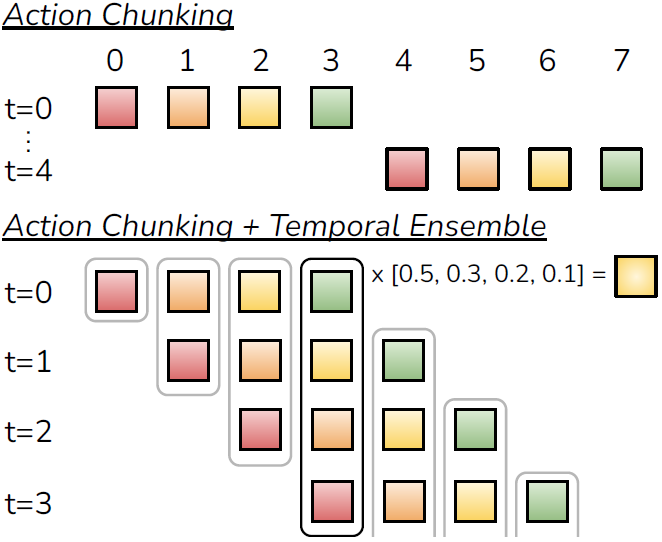
<!-- Fig. 5: We employ both Action Chunking and Temporal Ensembling when applying actions, instead of interleaving observing and executing. -->
图5: 我们在应用动作时, 同时采用Action Chunking和Temporal Ensembling, 而不是交错观察并执行。

<!-- A naïve implementation of action chunking can be suboptimal: a new environment observation is incorporated abruptly every $k$ steps and can result in jerky robot motion. To improve smoothness and avoid discrete switching between executing and observing, we query the policy at every timestep. This makes different action chunks overlap with each other, and at a given timestep there will be more than one predicted action. We illustrate this in Figure 5 and propose a *temporal ensemble* to combine these predictions. Our *temporal ensemble* performs a weighted average over these predictions with an exponential weighting scheme $w_i = \exp(-m ∗ i)$, where $w_0$ is the weight for the oldest action. The speed for incorporating new observation is governed by $m$, where a smaller $m$ means faster incorporation. We note that unlike typical smoothing, where the current action is aggregated with actions in adjacent timesteps, which leads to bias, we aggregate actions predicted for the *same* timestep. This procedure also incurs no additional training cost, only extra inference-time computation. In practice, we find both action chunking and temporal ensembling to be important for the success of ACT, which produces precise and smooth motion. We discuss these components in more detail in the ablation studies in Subsection VI-A. -->
Action chunking的简单实现不是最理想的: 每$k$步突然融入一个新的环境观察, 并会导致突然停止和启动的机器人运动。
为了提高平滑度, 并避免执行和观察之间的离散切换, 我们在每个时间步查询策略。
这使得不同的动作块相互重叠, 并且在给定的时间步, 将会有多个预测动作。
我们在[图5](#fig.5)中对此进行说明, 并提出一个*temporal ensemble*来组合这些预测。
我们的*temporal ensemble*使用指数加权方案$w_i = \exp(-m ∗ i)$对这些预测执行加权平均, 其中 $w_0$ 是最旧动作的权重。
融入新观察的速度由 $m$ 决定, 其中较小的 $m$ 意味着更快的融合。
我们注意到, 不像传统的平滑, 其中当前动作与相邻时间步的动作聚合, 这会导致偏差, 而我们聚合*相同*时间步的预测动作。
该程序也不产生额外的训练成本, 只产生额外的推理时间计算。
在实践中, 我们发现action chunking和temporal ensembling对于ACT的成功非常重要, ACT产生精确且平滑的运动。
我们在第[VI-A](#Action-Chunking-and-Temporal-Ensembling)小节的ablation研究中更详细地讨论了这些组成部分。

## Modeling human data
<!-- Another challenge that arises is learning from noisy human demonstrations. Given the same observation, a human can use different trajectories to solve the task. Humans will also be more stochastic in regions where precision matters less [38]. Thus, it is important for the policy to focus on regions where high precision matters. We tackle this problem by training our action chunking policy as a generative model. Specifically, we train the policy as a conditional variational autoencoder (CVAE) [55], to generate an action sequence conditioned on current observations. The CVAE has two components: a CVAE encoder and a CVAE decoder, illustrated on the left and right side of Figure 4 respectively. The CVAE encoder only serves to train the CVAE decoder (the policy) and is discarded at test time. Specifically, the CVAE encoder predicts the mean and variance of the style variable $z$'s distribution, which is parameterized as a diagonal Gaussian, given the current observation and action sequence as inputs. For faster training in practice, we leave out the image observations and only condition on the proprioceptive observation and the action sequence. The CVAE decoder, i.e. the policy, conditions on both $z$ and the current observations (images + joint positions) to predict the action sequence. At test time, we set $z$ to be the mean of the prior distribution i.e. zero to deterministically decode. The whole model is trained to maximize the log-likelihood of demonstration action chunks, i.e. $\min_{\theta} - \sum_{s_t, a_{t:t+k} \in D} \log \pi_{theta}(a_{t:t+k}|s_t)$, with the standard VAE objective which has two terms: a reconstruction loss and a term that regularizes the encoder to a Gaussian prior. Following [23], we weight the second term with a hyperparameter $\beta$. Intuitively, higher $\beta$ will result in less information transmitted in $z$ [62]. Overall, we found the CVAE objective to be essential in learning precise tasks from human demonstrations. We include a more detailed discussion in Subsection VI-B. -->
出现的另一个挑战是从嘈杂的人类演示中学习。
给定相同的观察, 人类可以使用不同的轨迹来解决任务。
在精度不太重要的区域, 人类也会更加随机[38]。
因此, 政策应重点关注高精度地区。
我们通过训练我们的action chunking策略成生成模型来解决这个问题。
具体来说, 我们训练该策略为条件变分自动编码器(CVAE)[55], 以生成以当前观察为条件的动作序列。
CVAE有两个组件: 一个CVAE编码器和一个CVAE解码器, 分别如[图4](#fig.4)的左侧和右侧所示。
CVAE编码器仅用于训练CVAE解码器(策略), 并在测试时被丢弃。
具体来说, CVAE编码器预测style变量$z$分布的均值和方差, 该分布被参数化为对角高斯分布, 给定的当前观察和动作序列作为输入。
为了在实践中更快的训练, 我们忽略了图像观察, 仅以本体感受观察和动作序列为条件。
CVAE解码器, 即策略, 以$z$和当前观察(图像+关节位置)为条件, 预测动作序列。
在测试时, 我们将$z$设置为先验分布的均值(即零), 以进行确定性解码。
整个模型被训练, 以最大化演示动作块的对数似然(即$\min_{\theta} - \sum_{s_t, a_{t:t+k} \in D} \log \pi_{theta}(a_{t:t+k}|s_t)$), 其具有标准VAE目标, 该目标有两项: 重建损失和将编码器正则化为高斯先验项。
按照[23], 我们用超参数$\beta$对第二项进行加权。
直观上, 较高的$\beta$将导致$z$中传输的信息较少[62]。
总的来说, 我们发现CVAE目标(对于从人类演示中学习精确任务)至关重要。
我们在第[VI-B](#Training-with-CVAE)小节中进行更详细的讨论。

<span id='fig.4'></span>
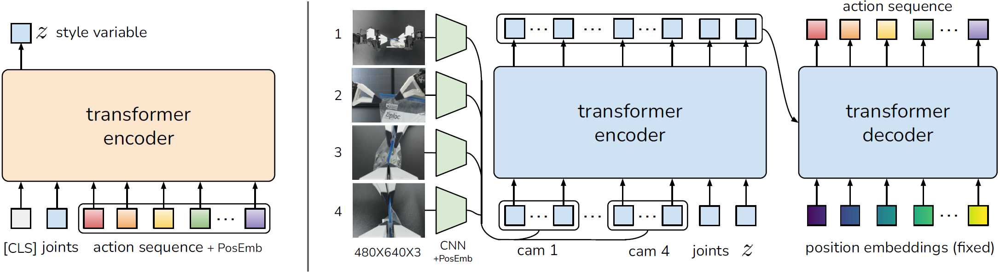
<!-- Fig. 4: Architecture of Action Chunking with Transformers (ACT). We train ACT as a Conditional VAE (CVAE), which has an encoder and a decoder. Left: The encoder of the CVAE compresses action sequence and joint observation into $z$, the style variable. The encoder is discarded at test time. Right: The decoder or policy of ACT synthesizes images from multiple viewpoints, joint positions, and $z$ with a transformer encoder, and predicts a sequence of actions with a transformer decoder. $z$ is simply set to the mean of the prior (i.e. zero) at test time. -->
图4: Action Chunking with Transformers (ACT)架构。
我们将ACT训练为条件VAE(CVAE), 它有一个编码器和一个解码器。
左: CVAE的编码器将动作序列和关节观察压缩到style变量$z$中。
编码器在测试时被丢弃。
右图: ACT的解码器或策略, 使用一个transformer编码器, 合成来自多个视点的图像、关节位置和$z$, 并使用一个transformer解码器, 预测一个动作序列。
$z$在测试时简单地设置为先验的平均值(即零)。

## Implementing ACT
<!-- We implement the CVAE encoder and decoder with transformers, as transformers are designed for both synthesizing information across a sequence and generating new sequences. The CVAE encoder is implemented with a BERT-like transformer encoder [13]. The inputs to the encoder are the current joint positions and the target action sequence of length $k$ from the demonstration dataset, prepended by a learned "[CLS]" token similar to BERT. This forms a $k+2$ length input (Figure 4 left). After passing through the transformer, the feature corresponding to "[CLS]" is used to predict the mean and variance of the "style variable" $z$, which is then used as input to the decoder. The CVAE decoder (i.e. the policy) takes the current observations and $z$ as the input, and predicts the next $k$ actions (Figure 4 right). We use ResNet image encoders, a transformer encoder, and a transformer decoder to implement the CVAE decoder. Intuitively, the transformer encoder synthesizes information from different camera viewpoints, the joint positions, and the style variable, and the transformer decoder generates a coherent action sequence. The observation includes 4 RGB images, each at $480 \times 640$ resolution, and joint positions for two robot arms ($7+7=14$ DoF in total). The action space is the absolute joint positions for two robots, a 14-dimensional vector. Thus with action chunking, the policy outputs a $k \times 14$ tensor given the current observation. The policy first process the images with ResNet18 backbones [22], which convert $480 \times 640 \times 3$ RGB images into $15 \times 20 \times 512$ feature maps. We then flatten along the spatial dimension to obtain a sequence of $300 \times 512$. To preserve the spatial information, we add a 2D sinusoidal position embedding to the feature sequence [8]. Repeating this for all 4 images gives a feature sequence of $1200 \times 512$ in dimension. We then append two more features: the current joint positions and the "style variable" $z$. They are projected from their original dimensions to 512 through linear layers respectively. Thus, the input to the transformer encoder is $1202 \times 512$. The transformer decoder conditions on the encoder output through cross-attention, where the input sequence is a fixed position embedding, with dimensions $k \times 512$, and the keys and values are coming from the encoder. This gives the transformer decoder an output dimension of $k \times 512$, which is then down-projected with an MLP into $k \times 14$, corresponding to the predicted target joint positions for the next $k$ steps. We use L1 loss for reconstruction instead of the more common L2 loss: we noted that L1 loss leads to more precise modeling of the action sequence. We also noted degraded performance when using delta joint positions as actions instead of target joint positions. We include a detailed architecture diagram in Appendix C. -->
我们使用Transformer实现CVAE编码器和解码器, 因为Transformer被设计用于合成序列中的信息并生成新序列。
CVAE编码器是用类似BERT的transformer编码器实现的[13]。
编码器的输入是来自演示数据集的当前关节位置和长度为 $k$ 的目标动作序列, 前缀为类似于BERT的学到的"[CLS]"词元。
这形成了一个长度为$k+2$的输入([图4](#fig.4)左)。
经过Transformer后, "[CLS]"对应的特征被用于预测"style变量"$z$的均值和方差, 然后将其作为解码器的输入。
CVAE解码器(即策略)将当前观察值和$z$作为输入, 并预测接下来的$k$个动作([图4](#fig.4)右)。
我们使用ResNet图像编码器、transformer编码器和transformer解码器来实现CVAE解码器。
直观地说, transformer编码器合成(来自不同相机视点、关节位置和style变量的)信息, transformer解码器生成连贯的动作序列。
观察包括4张RGB图像, 每张图像的分辨率为$480 \times 640$, 以及两个机器人手臂的关节位置(总共$7+7=14$个自由度)。
动作空间是两个机器人的绝对关节位置, 一个14维向量。
因此, 通过action chunking, 该策略在给定当前观察值的情况下输出一个$k \times 14$的张量。
该策略首先使用ResNet18 backbones[22]处理图像, 将$480 \times 640 \times 3$RGB图像转化为$15 \times 20 \times 512$特征图。
然后我们沿着空间维度展平, 得到一个$300 \times 512$的序列。
为了保留空间信息, 我们将2D正弦位置嵌入添加到特征序列中[8]。
对所有 4 个图像重复此操作, 得到一个维度为$1200 \times 512$的特征序列。
然后我们附加两个特征: 当前关节位置和"style变量"$z$。
它们分别通过线性层从原始维度投影到512。
因此, transformer编码器的输入为$1202 \times 512$。
Transformer解码器通过交叉注意力, 条件于编码器的输出, 其中输入序列是固定的位置嵌入, 维度为$k \times 512$, 键和值来自编码器。
这为transformer解码器提供了一个$k \times 512$的输出维度, 然后使用MLP将其向下投影为$k \times 14$, 对应于未来$k$步的预测目标关节位置。
我们使用L1 loss用于重建, 而不是更常见的L2 loss: 我们注意到L1 loss产生更精确的动作序列建模。
当使用增量关节位置(而不是目标关节位置)作为动作时, 我们还观察到性能下降。我们在[附录C](#Detailed-Architecture-Diagram)中提供了详细的架构图。

<!-- We summarize the training and inference of ACT in Algorithms [1](#Algorithm.1) and [2](#Algorithm.2). The model has around 80M parameters, and we train from scratch for each task. The training takes around 5 hours on a single 11G RTX 2080 Ti GPU, and the inference time is around 0.01 seconds on the same machine. -->
我们总结了[算法1](#Algorithm.1)和[算法2](#Algorithm.2)中ACT的训练和推理。
该模型大约80M个参数, 我们对每个任务从头开始训练。 
在单个11G RTX 2080 Ti GPU上训练花费大约5个小时, 在同一机器上推理时间约0.01秒。

---
**Algorithm 1<span id='Algorithm.1'></span>** ACT Training

---
&ensp;1: Given: Demo dataset $\mathcal{D}$, chunk size $k$, weight $\beta$.<br>
&ensp;2: Let $a_t$, $o_t$ represent action and observation at timestep $t$, $\bar{o}_t$ represent $o_t$ without image observations.<br>
&ensp;3: Initialize encoder $q_{\phi}\left( z | a_{t:t+k}, \bar{o}_t \right)$<br>
&ensp;4: Initialize decoder $\pi_{\theta}\left( \hat{a}_{t:t+k} | o_t, z \right)$<br>
&ensp;5: **for** iteration $n = 1, 2, \dots$ **do**<br>
&ensp;6: &ensp;&ensp;Sample $o_t$, $a_{t:t+k}$ from $\mathcal{D}$<br>
&ensp;7: &ensp;&ensp;Sample $z$ from $q_{\phi}\left( z | a_{t:t+k}, \bar{o}_t \right)$<br>
&ensp;8: &ensp;&ensp;Predict $\hat{a}_{t:t+k}$ from $\pi_{\theta}\left( \hat{a}_{t:t+k} | o_t, z \right)$<br>
&ensp;9: &ensp;&ensp;$\mathcal{L}_\text{reconst} = \textbf{MSE} \left( \hat{a}_{t:t+k}, a_{t:t+k} \right)$<br>
10: &ensp;&ensp;$\mathcal{L}_\text{reg} = D_\text{KL}\left( q_{\phi}(z | a_{t:t+k}, \bar{o}_t) || \mathcal{N}(0,I) \right)$<br>
11: &ensp;&ensp;Update $\theta$, $\phi$ with ADAM and $\mathcal{L} = \mathcal{L}_\text{reconst} + \beta \mathcal{L}_\text{reg}$

---
---
**Algorithm 2<span id='Algorithm.2'></span>** ACT Inference

---
1: Given: trained $\pi_{\theta}$, episode length $T$, weight $m$.<br>
2: Initialize FIFO buffers $\mathcal{B}[0 : T]$, where $\mathcal{B}[t]$ stores actions predicted for timestep $t$.<br>
3: **for** timestep $t = 1, 2, \dots, T$ **do**<br>
4: &ensp;&ensp;Predict $\hat{a}_{t:t+k}$ with $\pi_{\theta}\left( \hat{a}_{t:t+k} | o_t, z \right)$ where $z = 0$<br>
5: &ensp;&ensp;Add $\hat{a}_{t:t+k}$ to buffers $\mathcal{B}[t:t+k]$ respectively<br>
6: &ensp;&ensp;Obtain current step actions $A_t = \mathcal{B}[t]$<br>
7: &ensp;&ensp;Apply $a_t = \sum_i \frac{w_i A_t[i]}{\sum_i w_i}$, with $w_i = \exp(-m * i)$

---

# EXPERIMENTS
<!-- We present experiments to evaluate ACT's performance on fine manipulation tasks. For ease of reproducibility, we build two simulated fine manipulation tasks in MuJoCo [63], in addition to 6 real-world tasks with ALOHA. We provide videos for each task on the [project website](https://tonyzhaozh.github.io/aloha/). -->
我们通过实验, 评估ACT在精细操作任务上的表现。
为了便于复现, 我们在<font color="red">MuJoCo[63]</font>中构建了两个仿真精细操作任务, 此外使用ALOHA构建了6个现实世界任务。
我们在[项目网站](https://tonyzhaozh.github.io/aloha/)上提供了每个任务的视频。

## Tasks
<!-- All 8 tasks require fine-grained, bimanual manipulation, and are illustrated in Figure 6. For ***Slide Ziploc***, the right gripper needs to accurately grasp the slider of the ziploc bag and open it, with the left gripper securing the body of the bag. For ***Slot Battery***, the right gripper needs to first place the battery into the slot of the remote controller, then using the tip of fingers to delicately push in the edge of the battery, until it is fully inserted. Because the spring inside the battery slot causes the remote controller to move in the opposite direction during insertion, the left gripper pushes down on the remote to keep it in place. For ***Open Cup***, the goal is to open the lid of a small condiment cup. Because of the cup's small size, the grippers cannot grasp the body of the cup by just approaching it from the side. Therefore we leverage both grippers: the right fingers first lightly tap near the edge of the cup to tip it over, and then nudge it into the open left gripper. This nudging step requires high precision and closing the loop on visual perception. The left gripper then closes gently and lifts the cup off the table, followed by the right finger prying open the lid, which also requires precision to not miss the lid or damage the cup. The goal of ***Thread Velcro*** is to insert one end of a velcro cable tie into the small loop attached to other end. The left gripper needs to first pick up the velcro tie from the table, followed by the right gripper pinching the tail of the tie in mid-air. Then, both arms coordinate to insert one end of the velcro tie into the other in mid-air. The loop measures 3mm x 25mm, while the velcro tie measures 2mm x 10-25mm depending on the position. For this task to be successful, the robot must use visual feedback to correct for perturbations with each grasp, as even a few millimeters of error during the first grasp will compound in the second grasp mid-air, giving more than a 10mm deviation in the insertion phase. For ***Prep Tape***, the goal is to hang a small segment of the tape on the edge of a cardboard box. The right gripper first grasps the tape and cuts it with the tape dispenser's blade, and then hands the tape segment to the left gripper mid-air. Next, both arms approach the box, the left arm gently lays the tape segment on the box surface, and the right fingers push down on the tape to prevent slipping, followed by the left arm opening its gripper to release the tape. Similar to *Thread Velcro*, this task requires multiple steps of delicate coordination between the two arms. For ***Put On Shoe***, the goal is to put the shoe on a fixed manniquin foot, and secure it with the shoe's velcro strap. The arms would first need to grasp the tongue and collar of the shoe respectively, lift it up and approach the foot. Putting the shoe on is challenging because of the tight fitting: the arms would need to coordinate carefully to nudge the foot in, and both grasps need to be robust enough to counteract the friction between the sock and shoe. Then, the left arm goes around to the bottom of the shoe to support it from dropping, followed by the right arm flipping the velcro strap and pressing it against the shoe to secure. The task is only considered successful if the shoe clings to the foot after both arms releases. For the simulated task ***Transfer Cube***, the right arm needs to first pick up the red cube lying on the table, then place it inside the gripper of the other arm. Due to the small clearance between the cube and the left gripper (around 1cm), small errors could result in collisions and task failure. For the simulated task ***Bimanual Insertion***, the left and right arms need to pick up the socket and peg respectively, and then insert in mid-air so the peg touches the "pins" inside the socket. The clearance is around 5mm in the insertion phase. For all 8 tasks, the initial placement of the objects is either varied randomly along the 15cm white reference line (real-world tasks), or uniformly in 2D regions (simulated tasks). We provide illustrations of both the initial positions and the subtasks in Figure 6 and 7. Our evaluation will additionally report the performance for each of these subtasks. -->
所有8项任务都需要细粒度的双手操作, 如[图6](#fig.6)所示。
对于***滑动密封袋***, 右夹具需要准确地抓住密封袋的滑块并将其打开, 左夹具固定袋体。
对于***插入电池***, 右夹具需要先将电池放入遥控器的槽内, 然后使用指尖轻轻推动电池边缘, 直至它被完全插入。
由于电池槽内的弹簧导致遥控器(在插入过程中)向相反方向移动, 因此左夹具向下推遥控器以保持原位。
对于***打开杯子***, 目标是打开一个小型调味品杯的盖子。
由于杯子尺寸较小, 夹具无法仅从侧面接近杯子主体来握住杯子的主体。
因此, 我们利用两个夹具: 首先用右手手指轻轻点击杯子边缘附近, 将其翻过来, 然后将其轻推入打开的左夹具中。
这一轻推步骤需要高精度并视觉感知闭环。
然后, 左夹具轻轻闭合, 将杯子从桌子上提起, 然后用右手指撬开盖子, 这也需要精确度, 以免错过盖子或损坏杯子。
***穿魔术贴***的目标是将魔术贴扎带的一端插入附着在另一端的小环中。
左夹具需要首先从桌子上拿起魔术贴, 然后右夹具在半空中捏住魔术贴的尾部。
然后, 双臂协作在半空中将魔术贴的一端插入另一端。
环的尺寸为3mm x 25mm, 魔术贴的尺寸为2mm x 10-25mm, 取决于位置。
为了成功完成这项任务, 机器人必须使用视觉反馈来纠正每次抓取的扰动, 因为即使第一次抓取中的几毫米误差, 也将会(在第二次半空抓取中)复合, 导致插入阶段的超过10mm的偏差。
对于***准备胶带***, 目标是将一小段胶带悬挂在纸板箱的边缘。
右夹具首先抓住胶带并用胶带分配器的刀片将其切割, 然后将胶带段交给半空中的左夹具。
接下来, 双臂靠近盒子, 左臂轻轻地将胶带段放在盒子表面, 右手手指向下推胶带以防止滑动, 然后左臂打开夹子以松开胶带。
与*穿魔术贴*类似, 这项任务需要两个手臂之间多个步骤的微妙协调。
对于***穿鞋***, 目标是将鞋子放在固定的人体模型脚上, 并用鞋子的魔术带将其固定。
手臂首先需要分别抓住鞋舌和鞋领, 将其抬起并靠近脚部。
由于紧密贴合, 穿鞋是一项挑战: 手臂需要仔细配合才能将脚推入, 并且两个抓握都需要足够有力, 以抵消袜子和鞋子之间的摩擦。
然后, 左臂绕到鞋子底部以支撑它不掉落, 然后右臂翻转魔术带, 并将其压在鞋子上以进行固定。
如果当双臂松开后鞋子紧贴脚, 任务才被认为成功。
对于***传递立方体***的模拟任务, 右臂需要首先拿起桌子上的红色立方体, 然后将其放入另一只手臂的夹具内。
由于立方体和左夹具之间的很小间隙(约1厘米), 微小的错误可能会导致碰撞和任务失败。
对于***双手插入***的模拟任务, 左臂和右臂需要分别拿起插座和钉子, 然后在半空中插入, 使钉子碰触到插座内的"针"。
插入阶段间隙约为5mm。
对于所有8个任务, 物体的初始放置要么沿着15厘米白色参考线随机变化(真实世界任务), 要么在2D区域中均匀变化(模拟任务)。
我们在[图6](#fig.6)和[图7](#fig.7)中提供了初始位置和子任务的插图。
我们的评估将另外报告每个子任务的性能。

<!-- In addition to the delicate bimanual control required to solve these tasks, the objects we use also present a significant perception challenge. For example, the ziploc bag is largely transparent, with a thin blue sealing line. Both the wrinkles on the bag and the reflective candy wrappers inside can vary during the randomization, and distract the perception system. Other transparent or translucent objects include the tape and both the lid and body of the condiment cup, making them hard to perceive precisely and ill-suited for depth cameras. The black table top also creates a low-contrast against many objects of interest, such as the black velcro cable tie and the black tape dispenser. Especially from the top view, it is challenging to localize the velcro tie because of the small projected area. -->
除了解决这些任务所需的精巧的双手控制之外, 我们使用的物体也遇到了重大的感知挑战。
例如, 密封袋基本上是透明的, 有一条细的蓝色密封线。
袋子上的褶皱和内部的反光糖果包装纸在随机变化, 并分散感知系统的注意。
其他透明或半透明物体包括胶带以及调味杯的盖子和杯体, 这使得它们难以精确感知, 并且不适合深度相机。
黑色桌面还与许多感兴趣的物体形成低对比度, 例如黑色魔术贴扎带和黑色胶带分配器。
特别是从顶视图来看, 由于投影面积较小, 定位魔术贴扎带具有挑战性。

## Data Collection
<!-- For all 6 real-world tasks, we collect demonstrations using ALOHA teleoperation. Each episode takes 8-14 seconds for the human operator to perform depending on the complexity of the task, which translates to 400-700 time steps given the control frequency of 50Hz. We record 50 demonstrations for each task, except for *Thread Velcro* which has 100. The total amount for demonstrations is thus around 10-20 minutes of data for each task, and 30-60 minutes in wall-clock time because of resets and teleoperator mistakes. For the two simulated tasks, we collect two types of demonstrations: one type with a scripted policy and one with human demonstrations. To teleoperate in simulation, we use the "leader robots" of ALOHA to control the simulated robot, with the operator looking at the real-time renderings of the environment on the monitor. In both cases, we record 50 successful demonstrations. -->
对于所有6个现实世界任务, 我们使用ALOHA远程操作收集演示。
根据任务的复杂度, 操作员执行每个episode需要8-14秒, 给定50Hz的控制频率, 它转化为400-700个时间步。
我们为每个任务记录50次演示, 除了*穿魔术贴*的演示, 它有100次。
因此, 对于每个任务, 演示总量约为10-20分钟的数据, 由于重置和远程操作员失误, 需要30-60分钟的挂钟时间。
对于两个模拟任务, 我们收集了两种类型的演示: 一种是脚本化策略, 另一种是人工演示。
为了在模拟中进行远程操作，我们使用ALOHA的"leader机器人"控制模拟机器人, 操作员在监视器上查看环境的实时渲染图。
在这两种情况下, 我们记录50次成功的演示。

<!-- We emphasize that all human demonstrations are inherently stochastic, even though a single person collects all of the demonstrations. Take the mid-air hand handover of the tape segment as an example: the exact position of the handover is different across each episode. The human has no visual or haptic reference to perform it in the same position. Thus to successfully perform the task, the policy will need to learn that the two grippers should never collide with each other during the handover, and the left gripper should always move to a position that can grasp the tape, instead of trying to memorize where exactly the handover happens, which can vary across demonstrations. -->
我们强调, 所有人类演示本质上都是随机的, 即使一个人收集所有演示。
以胶带段的空中传递为例: 每个episode中传递的精确位置都不同。
人类没有视觉或触觉参考来在同一位置执行该操作。
因此, 为了成功执行任务, 该策略需要学习两个夹具在传递过程中决不应该相互碰撞, 并且左侧夹具应该始终移动到可以抓住带子的位置, 而不是试图记住传递发生的精确位置, 这会随不同演示而发生变化。

## Experiment Results
<!-- We compare ACT with four prior imitation learning methods. ***BC-ConvMLP*** is the simplest yet most widely used baseline [69, 26], which processes the current image observations with a convolutional network, whose output features are concatenated with the joint positions to predict the action. ***BeT*** [49] also leverages Transformers as the architecture, but with key differences: (1) no action chunking: the model predicts one action given the history of observations; and (2) the image observations are pre-processed by a separately trained frozen visual encoder. That is, the perception and control networks are not jointly optimized. ***RT-1*** [7] is another Transformer-based architecture that predicts one action from a fixed-length history of past observations. Both BeT and RT-1 discretize the action space: the output is a categorical distribution over discrete bins, but with an added continuous offset from the bin-center in the case of BeT. Our method, ACT, instead directly predicts continuous actions, motivated by the precision required in fine manipulation. Lastly, ***VINN*** [42] is a non-parametric method that assumes access to the demonstrations at test time. Given a new observation, it retrieves the k observations with the most similar visual features, and returns an action using weighted k-nearest-neighbors. The visual feature extractor is a pretrained ResNet finetuned on demonstration data with unsupervised learning. We carefully tune the hyperparameters of these four prior methods using cube transfer. Details of the hyperparameters are provided in Appendix D. -->
我们将ACT与之前的四种模仿学习方法进行比较。
***BC-ConvMLP***是最简单但广泛使用的基线[69, 26], 它使用卷积网络处理当前图像观测, 其输出特征与关节位置有关以预测动作。
***BeT***[49]也利用Transformers作为架构, 但有一些关键区别:
(1) 无action chunking: 模型根据观察历史预测一个动作;
(2) 图像观察结果由单独训练好的冻结的视觉编码器进行预处理。
也就是说, 感知和控制网络没有被联合优化。
***RT-1***[7]是另一种基于Transformer的架构, 它从固定长度的过去观察历史, 预测一个动作。
BeT和RT-1都离散化动作空间: 输出是离散bins上的分类分布, 但在BeT的情况下, 增加了距bin中心的连续偏移。
相反, 我们的方法ACT直接预测连续动作, 其动机是精细操作所需的精度。
最后, ***VINN***[42]是一种非参数方法, 假设在测试时访问演示。
给定一个新的观察结果, 它检索具有最相似视觉特征的$k$个观察结果, 并使用加权的k-nearest-neighbors返回一个动作。
视觉特征提取器是一个预训练的ResNet, 通过无监督学习在演示数据上进行微调。
我们使用立方体传递任务仔细调整这四种先前方法的超参数。
[附录D](#Experiment-Details-and-Hyperparameters)中提供了超参数的详细信息。

<!-- As a detailed comparison with prior methods, we report the average success rate in Table I for two simulated and two real tasks. For simulated tasks, we average performance across 3 random seeds with 50 trials each. We report the success rate on both scripted data (left of separation bar) and human data (right of separation bar). For real-world tasks, we run one seed and evaluate with 25 trials. ACT achieves the highest success rate compared to all prior methods, outperforming the second best algorithm by a large margin on each task. For the two simulated tasks with scripted or human data, ACT outperforms the best previous method in success rate by 59%, 49%, 29%, and 20%. While previous methods are able to make progress in the first two subtasks, the final success rate remains low, below 30%. For the two real-world tasks *Slide Ziploc* and *Slot Battery*, ACT achieves 88% and 96% final success rates respectively, with other methods making no progress past the first stage. We attribute the poor performance of prior methods to compounding errors and non-Markovian behavior in the data: the behavior degrades significantly towards the end of an episode, and the robot can pause indefinitely for certain states. ACT mitigates both issues with action chunking. Our ablations in Subsection VI-A also shows that chunking can significantly improve these prior methods when incorporated. In addition, we notice a drop in performance for all methods when switching from scripted data to human data in simulated tasks: the stochasticity and multi-modality of human demonstrations make imitation learning a lot harder. -->
作为与现有方法的详细对比, 我们在[表I](#table.I)中报告了两个模拟任务和两个真实任务的平均成功率。
对于模拟任务, 我们对3个随机seeds的性能进行平均, 每个seeds进行50次试验。
我们报告了脚本数据(分隔栏左侧)和人工数据(分隔栏右侧)的成功率。
对于现实世界的任务, 我们运行一次seed并通过25次试验进行评估。
与所有之前方法相比, ACT获得最高的成功率, 在每项任务上都大幅优于第二好的算法。
对于使用脚本或人工数据的两项模拟任务, ACT在成功率方面比之前最好的方法高出59%、49%、29%和20%。
虽然以前的方法能够在前两项子任务中取得进展, 但最终的成功率仍然很低, 低于30%。
对于*滑动密封袋*和*插入电池*这两个现实任务, ACT分别达到88%和96%的最终成功率, 而其他方法在第一阶段之后没有任何进展。
我们将先前方法的较差性能归因于复合误差和数据中的非马尔可夫行为: 接近episode结束时, 行为显着恶化, 并且对于某些状态, 机器人能无限期地暂停。
ACT通过action chunking缓解了这两个问题。
我们在第[VI-A](#Action-Chunking-and-Temporal-Ensembling)小节中的ablations也表明, 当集成时, 分块可以显着改进这些先前的方法。
此外, 在模拟任务中从脚本数据切换到人类数据时, 我们注意到所有方法的性能都下降: 人类演示的随机性和多模态使得模仿学习变得更加困难。

<!-- TABLE I: Success rate (%) for 2 simulated and 2 real-world tasks, comparing our method with 4 baselines. For the two simulated tasks, we report [training with scripted data | training with human data], with 3 seeds and 50 policy evaluations each. For the real-world tasks, we report training with human data, with 1 seed and 25 evaluations. Overall, ACT significantly outperforms previous methods. -->
<table>
    <caption>表I: <span id='table.I'></span> 2项模拟任务和2项现实世界任务的成功率(%), 将我们的方法与4个基线进行比较。
对于这两项模拟任务, 我们报告了[使用脚本数据进行的训练|用人类数据进行的训练], 3个seeds和每个seed有50个策略评估。
对于现实世界的任务, 我们报告了使用人类数据进行的训练, 1个seed和25次评估。
总体而言, ACT明显优于以前的方法。</caption>
<thead>
  <tr>
    <th style="text-align: center" rowspan="2"></th>
    <th style="text-align: center; background-color: #D6EAF8" colspan="3"><u>Cube Transfer (sim)</u></th>
    <th style="text-align: center" colspan="3"><u>Bimanual Insertion (sim)</u></th>
    <th style="text-align: center; background-color: #D6EAF8" colspan="3"><u>Slide Ziploc (real)</u></th>
    <th style="text-align: center" colspan="3"><u>Slot Battery (real)</u></th>
  </tr>
  <tr>
    <th style="text-align: center; background-color: #D6EAF8">Touched</th>
    <th style="text-align: center; background-color: #D6EAF8">Lifted</th>
    <th style="text-align: center; background-color: #D6EAF8">Transfer</th>
    <th style="text-align: center">Grasp</th>
    <th style="text-align: center">Contact</th>
    <th style="text-align: center">Insert</th>
    <th style="text-align: center; background-color: #D6EAF8">Grasp</th>
    <th style="text-align: center; background-color: #D6EAF8">Pinch</th>
    <th style="text-align: center; background-color: #D6EAF8">Open</th>
    <th style="text-align: center">Grasp</th>
    <th style="text-align: center">Place</th>
    <th style="text-align: center">Insert</th>
  </tr>
</thead>
<tbody>
  <tr>
    <td style="text-align: left">BC-ConvMLP</td>
    <td style="text-align: center; background-color: #D6EAF8">34 | 3</td>
    <td style="text-align: center; background-color: #D6EAF8">17 | 1</td>
    <td style="text-align: center; background-color: #D6EAF8">1 | 0</td>
    <td style="text-align: center">5 | 0</td>
    <td style="text-align: center">1 | 0</td>
    <td style="text-align: center">1 | 0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
  </tr>
  <tr>
    <td style="text-align: left">BeT</td>
    <td style="text-align: center; background-color: #D6EAF8">60 | 16</td>
    <td style="text-align: center; background-color: #D6EAF8">51 | 13</td>
    <td style="text-align: center; background-color: #D6EAF8">27 | 1</td>
    <td style="text-align: center">21 | 0</td>
    <td style="text-align: center">4 | 0</td>
    <td style="text-align: center">3 | 0</td>
    <td style="text-align: center; background-color: #D6EAF8">8</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">4</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
  </tr>
  <tr>
    <td style="text-align: left">RT-1</td>
    <td style="text-align: center; background-color: #D6EAF8">44 | 4</td>
    <td style="text-align: center; background-color: #D6EAF8">33 | 2</td>
    <td style="text-align: center; background-color: #D6EAF8">2 | 0</td>
    <td style="text-align: center">2 | 0</td>
    <td style="text-align: center">0 | 0</td>
    <td style="text-align: center">1 | 0</td>
    <td style="text-align: center; background-color: #D6EAF8">4</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">4</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
  </tr>
  <tr>
    <td style="text-align: left">VINN</td>
    <td style="text-align: center; background-color: #D6EAF8">13 | 17</td>
    <td style="text-align: center; background-color: #D6EAF8">9 | 11</td>
    <td style="text-align: center; background-color: #D6EAF8">3 | 0</td>
    <td style="text-align: center">6 | 0</td>
    <td style="text-align: center">1 | 0</td>
    <td style="text-align: center">1 | 0</td>
    <td style="text-align: center; background-color: #D6EAF8">28</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">20</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
  </tr>
  <tr>
    <td style="text-align: left">ACT (Ours)</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{97 | 82}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{90 | 60}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{86 | 50}$$</td>
    <td style="text-align: center">$$\textbf{93 | 76}$$</td>
    <td style="text-align: center">$$\textbf{90 | 66}$$</td>
    <td style="text-align: center">$$\textbf{32 | 20}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{92}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{96}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{88}$$</td>
    <td style="text-align: center">$$\textbf{100}$$</td>
    <td style="text-align: center">$$\textbf{100}$$</td>
    <td style="text-align: center">$$\textbf{96}$$</td>
  </tr>
</tbody>
</table>

<!-- We report the success rate of the 3 remaining real-world tasks in Table II. For these tasks, we only compare with BeT, which has the highest task success rate so far. Our method ACT reaches 84% success for *Cup Open*, 20% for *Thread Velcro*, 64% for *Prep Tape* and 92% for *Put On Shoe*, again outperforming BeT, which achieve zero final success on these challenging tasks. We observe relatively low success of ACT in Thread Velcro, where the success rate decreased by roughly half at every stage, from 92% success at the first stage to 20% final success. The failure modes we observe are 1) at stage 2, the right arm closes its gripper too early and fails to grasp the tail of the cable tie mid-air, and 2) in stage 3, the insertion is not precise enough and misses the loop. In both cases, it is hard to determine the exact position of the cable tie from image observations: the contrast is low between the black cable tie and the background, and the cable tie only occupies a small fraction of the image. We include examples of image observations in Appendix B. -->
我们在[表II](#table.II)中报告了剩余3个现实世界任务的成功率。
对于这些任务, 我们只与(迄今为止任务成功率最高的)BeT进行比较。
我们的方法ACT在*打开杯子*中取得84%的成功率, 在*穿魔术贴*中取得20%的成功率, 在*准备胶带*中取得64%的成功率, 在*穿鞋*中取得92%的成功率, 再次优于BeT, 后者在这些具有挑战性的任务中最终取得零成功率。
我们观察到ACT在*穿魔术贴*中的成功率相对较低, 在每个阶段成功率大约下降一半, 从第一阶段的92%成功率到最终的20%成功率。
我们观察到的失败模式是: 1) 在第2阶段, 右臂过早闭合其夹具, 未能在半空中抓住扎带尾部; 2) 在第3阶段, 插入不够精确, 错过环形。
在这两种情况下, 很难从图像观察中确定扎带的精确位置: 黑色扎带与背景之间的对比度较低, 并且扎带仅占据图像的一小部分。
我们在[附录B](#Example-Image-Observations)中提供了图像观察的示例。

<!-- TABLE II: Success rate (%) for the remaining 3 real-world tasks. We only compare with the best performing baseline BeT. -->
<table>
    <caption>表II: <span id='table.II'></span> 剩余3项现实世界任务的成功率(%)。我们仅与表现最好的基线BeT进行比较。</caption>
<thead>
  <tr>
    <th style="text-align: center" rowspan="2"></th>
    <th style="text-align: center; background-color: #D6EAF8" colspan="3"><u>Open Cup (real)</u></th>
    <th style="text-align: center" colspan="3"><u>Thread Velcro (real)</u></th>
    <th style="text-align: center; background-color: #D6EAF8" colspan="4"><u>Prep Tape (real)</u></th>
    <th style="text-align: center" colspan="4"><u>Put On Shoe (real)</u></th>
  </tr>
  <tr>
    <th style="text-align: center; background-color: #D6EAF8">Tip Over</th>
    <th style="text-align: center; background-color: #D6EAF8">Grasp</th>
    <th style="text-align: center; background-color: #D6EAF8">Open Lid</th>
    <th style="text-align: center">Lift</th>
    <th style="text-align: center">Grasp</th>
    <th style="text-align: center">Insert</th>
    <th style="text-align: center; background-color: #D6EAF8">Grasp</th>
    <th style="text-align: center; background-color: #D6EAF8">Cut</th>
    <th style="text-align: center; background-color: #D6EAF8">Handover</th>
    <th style="text-align: center; background-color: #D6EAF8">Hang</th>
    <th style="text-align: center">Lift</th>
    <th style="text-align: center">Insert</th>
    <th style="text-align: center">Support</th>
    <th style="text-align: center">Secure</th>
  </tr>
</thead>
<tbody>
  <tr>
    <td style="text-align: left">BeT</td>
    <td style="text-align: center; background-color: #D6EAF8">12</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">24</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center; background-color: #D6EAF8">8</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center; background-color: #D6EAF8">0</td>
    <td style="text-align: center">12</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
    <td style="text-align: center">0</td>
  </tr>
  <tr>
    <td style="text-align: left">ACT (Ours)</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{100}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{96}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{84}$$</td>
    <td style="text-align: center">$$\textbf{92}$$</td>
    <td style="text-align: center">$$\textbf{40}$$</td>
    <td style="text-align: center">$$\textbf{20}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{96}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{92}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{72}$$</td>
    <td style="text-align: center; background-color: #D6EAF8">$$\textbf{64}$$</td>
    <td style="text-align: center">$$\textbf{100}$$</td>
    <td style="text-align: center">$$\textbf{92}$$</td>
    <td style="text-align: center">$$\textbf{92}$$</td>
    <td style="text-align: center">$$\textbf{92}$$</td>
  </tr>
</tbody>
</table>

# ABLATIONS
<!-- ACT employs action chunking and temporal ensembling to mitigate compounding errors and better handle non-Markovian demonstrations. It also trains the policy as a conditional VAE to model the noisy human demonstrations. In this section, we ablate each of these components, together with a user study that highlights the necessity of high-frequency control in ALOHA. We report results across a total of four settings: two simulated tasks with scripted or human demonstration. -->
ACT采用action chunking和temporal ensembling, 减少复合错误并更好地处理非马尔可夫演示。
它还将策略训练为条件VAE, 以建模嘈杂的人类演示。
在本节中, 我们消融每个组件以及一个用户研究, 后者强调ALOHA中高频控制的必要性。
我们报告了总共四种配置的结果: 两个(使用脚本或人类演示的)模拟任务。

## Action Chunking and Temporal Ensembling
<!-- In Subsection [V-C](#Experiment-Results), we observed that ACT significantly outperforms previous methods that only predict single-step actions, with the hypothesis that action chunking is the key design choice. Since $k$ dictates how long the sequence in each "chunk" is, we can analyze this hypothesis by varying $k$. $k = 1$ corresponds to no action chunking, and $k = \mathit{episode\_length}$ corresponds to fully open-loop control, where the robot outputs the entire episode's action sequence based on the first observation. We disable temporal ensembling in these experiments to only measure the effect of chunking, and trained separate policies for each $k$. In Figure 8 (a), we plot the success rate averaged across 4 settings, corresponding to 2 simulated tasks with either human or scripted data, with the blue line representing ACT without the temporal ensemble. We observe that performance improves drastically from 1% at $k = 1$ to 44% at $k = 100$, then slightly tapers down with higher $k$. This illustrates that more chunking and a lower effective horizon generally improve performance. We attribute the slight dip at $k = 200, 400$ (i.e., close to open-loop control) to the lack of reactive behavior and the difficulty in modeling long action sequences. To further evaluate the effectiveness and generality of action chunking, we augment two baseline methods with action chunking. For *BC-ConvMLP*, we simply increase the output dimension to $k * \mathit{action\_dim}$, and for *VINN*, we retrieve the next $k$ actions. We visualize their performance in Figure 8 (a) with different $k$, showing trends consistent with ACT, where more action chunking improves performance. While ACT still outperforms both augmented baselines with sizable gains, these results suggest that action chunking is generally beneficial for imitation learning in these settings. -->
在第[V-C](#Experiment-Results)小节中, 我们观察到ACT明显优于先前的方法, 这些方法仅预测一步动作, 假设action chunking是关键的设计选择。
由于$k$决定了每个"块"中的序列有多长, 因此我们可以通过改变$k$来分析这个假设。
$k = 1$对应于无action chunking, $k = \mathit{episode\_length}$对应于完全开环控制, 其中机器人基于第一次观察, 输出整个episode的动作序列。
我们在这些实验中禁用temporal ensembling, 仅测量分块的效果, 并为每个$k$训练单独的策略。
在[图8](#fig.8)(a) 中, 我们绘制了4个配置的平均成功率, 对应于使用人类或脚本数据的2个模拟任务, 其中蓝线代表没有temporal ensemble的ACT。
我们观察到, 性能从$k = 1$时的1%大幅提高到$k = 100$时的44%, 然后随着$k$的升高而略有下降。
这说明更多的分块和更低的有效范围通常会提高性能。
我们将$k = 200, 400$(即接近开环控制)处的轻微下降归因于反应行为的缺乏以及对长动作序列建模困难。
为了进一步评估action chunking的有效性和通用性, 我们用action chunking增强了两种基线方法。
对于*BC-ConvMLP*, 我们仅将输出维度增加到$k * \mathit{action\_dim}$, 对于*VINN*, 我们检索接下来的$k$个动作。
我们在[图8](#fig.8)(a)中用不同的$k$, 可视化他们的表现, 显示了与ACT一致的趋势, 其中更多的action chunking可以提高表现。
尽管ACT仍旧优于两种增强的基线, 并获得可观的收益, 但这些结果表明, action chunking通常有利于这些配置中的模仿学习。

<!-- We then ablate the temporal ensemble by comparing the highest success rate with or without it, again across the 4 aforementioned tasks and different $k$. We note that experiments with and without the temporal ensemble are separately tuned: hyperparameters that work best for no temporal ensemble may not be optimal with a temporal ensemble. In Figure 8 (b), we show that *BC-ConvMLP* benefits from temporal ensembling the most with a 4% gain, followed by a 3.3% gain for our method. We notice a performance drop for *VINN*, a non-parametric method. We hypothesize that a temporal ensemble mostly benefits parametric methods by smoothing out the modeling errors. In contrast, *VINN* retrieves ground-truth actions from the dataset and does not suffer from this issue. -->
接下来, 我们再次对上述4个任务和不同的$k$, 通过比较有或无temporal ensemble的最高成功率, 消融temporal ensemble。
我们注意到, 有和无temporal ensemble的实验是分开调整的: (最适合无temporal ensemble的)超参数对于temporal ensemble可能不是最佳的。
在[图8](#fig.8)(b)中, 我们发现*BC-ConvMLP*从temporal ensembling中获益最多, 增益为4%, 其次是我们的方法, 增益为3.3%。
我们注意到非参数方法*VINN*的性能下降。
我们假设temporal ensemble主要通过平滑建模误差而使参数方法受益。相比之下, *VINN*从数据集中检索真值动作, 并且不会遇到此问题。

## Training with CVAE
<!-- We train ACT with CVAE objective to model human demonstrations, which can be noisy and contain multi-modal behavior. In this section, we compare with ACT without the CVAE objective, which simply predicts a sequence of actions given current observation, and trained with L1 loss. In Figure 8 (c), we visualize the success rate aggregated across 2 simulated tasks, and separately plot training with scripted data and with human data. We can see that when training on scripted data, the removal of CVAE objective makes almost no difference in performance, because dataset is fully deterministic. While for human data, there is a significant drop from 35.3% to 2%. This illustrates that the CVAE objective is crucial when learning from human demonstrations. -->
我们以CVAE为目标, 训练ACT以模拟人类演示, 这些演示很嘈杂并且包含多模态行为。
在本节中, 我们与无CVAE目标的ACT进行对比, 对照方法仅根据当前观察结果预测一系列动作, 并使用L1损失进行训练。
在[图8](#fig.8)(c)中, 我们可视化了2个模拟任务汇总的成功率, 并分别绘制了使用脚本数据和人工数据进行的训练。
我们可以看到, 在脚本数据上进行训练时, CVAE目标的移除对性能几乎没有影响, 因为数据集是完全确定性的。
而对于人类数据, 则从35.3%显著下降至2%。
这说明当从人类演示中学习时, CVAE目标至关重要。

## Is High-Frequency Necessary?
<!-- Lastly, we conduct a user study to illustrate the necessity of high-frequency teleoperation for fine manipulation. With the same hardware setup, we lower the frequency from 50Hz to 5Hz, a control frequency that is similar to recent works that use high-capacity deep networks for imitation learning [7, 70]. We pick two fine-grained tasks: threading a zip cable tie and un-stacking two plastic cups. Both require millimeter-level precision and closed-loop visual feedback. We perform the study with 6 participants who have varying levels of experience with teleoperation, though none had used ALOHA before. The participants were recruited from among computer science graduate students, with 4 men and 2 women aged 22-25 The order of tasks and frequencies are randomized for each participant, and each participant was provided with a 2 minutes practice period before each trial. We recorded the time it took to perform the task for 3 trials, and visualize the data in Figure 8 (d). On average, it took 33s for participants to thread the zip tie at 5Hz, which is lowered to 20s at 50Hz. For separating plastic cups, increasing the control frequency lowered the task duration from 16s to 10s. Overall, our setup (i.e. 50Hz) allows the participants to perform highly dexterous and precise tasks in a short amount of time. However, reducing the frequency from 50Hz to 5Hz results in a 62% increase in teleoperation time. We then use "Repeated Measures Designs", a statistical procedure, to formally verify that 50Hz teleoperation outperforms 5Hz with $\text{p-value} < 0.001$. We include more details about the study in Appendix E. -->
最后, 我们进行了一项用户研究, 以说明(对于精细操作)高频远程操作的必要性。
在相同的硬件配置下, 我们将频率从50Hz降低到5Hz, 该控制频率类似于最近(使用高容量深度网络进行模仿学习的)工作[7, 70]。
我们选择两项细粒度的任务: 穿扎带和分开两个塑料杯。
两者都需要毫米级精度和闭环视觉反馈。
我们与6名参与者进行了这项研究, 他们具有不同程度的远程操作经验, 但之前没有人使用过ALOHA。
参与者是从计算机科学研究生中招募的, 其中4名男性和2名女性, 年龄在22-25岁之间。对于每个参与者, 任务顺序和频率是随机的, 每个参与者在每次试验前都有2分钟的练习时间。
我们记录了3次试验中执行任务所需的时间, 并将数据可视化, 如[图8](#fig.8)(d)所示。
平均而言, 参与者在5Hz下穿扎带需要33秒, 在50Hz下则缩短至20秒。
对于分开塑料杯, 增加控制频率将任务持续时间从16秒降低到10秒。
总体而言, 我们的配置(即 50Hz)允许参与者在短时间内执行高度灵巧和精确的任务。
然而, 将频率从50Hz降低到5Hz导致远程操作时间增加62%。
然后, 我们使用"重复测量设计"(一种统计程序), 以正式验证50Hz远程操作优于5Hz, 且$\text{p-value} < 0.001$。
我们在[附录E](#User-Study-Details)中提供了有关该研究的更多详细信息。

<span id='fig.8'></span>
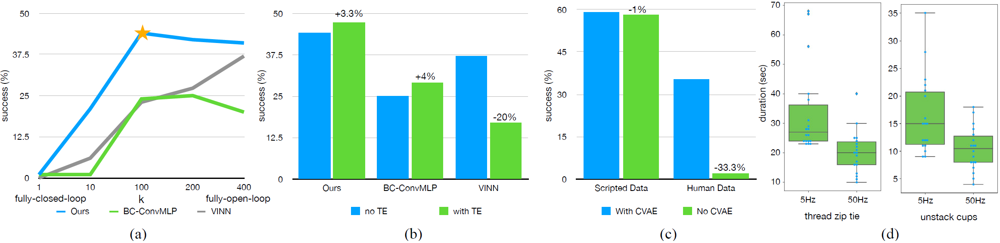
<!-- Fig. 8: (a) We augment two baselines with action chunking, with different values of chunk size $k$ on the $x$-axis, and success rate on the $y$-axis. Both methods significantly benefit from action chunking, suggesting that it is a generally useful technique. (b) Temporal Ensemble (TE) improves our method and *BC-ConvMLP*, while hurting *VINN*. (c) We compare with and without the CVAE training, showing that it is crucial when learning from human data. (d) We plot the distribution of task completion time in our user study, where we task participants to perform two tasks, at 5Hz or 50Hz teleoperation frequency. Lowering the frequency results in a 62% slowdown in completion time. -->
图8: (a) 我们通过action chunking增强两个基线, $x$轴为块大小$k$的不同值, $y$轴为成功率。
这两种方法都显着受益于action chunking, 这表明它是一种通常有用的技术。
(b) Temporal Ensemble(TE)改进了我们的方法和*BC-ConvMLP*, 同时损害了*VINN*。
(c) 我们比较了有和无CVAE的训练, 表明从人类数据中学习时, CVAE至关重要。
(d) 我们在用户研究中绘制了任务完成时间的分布, 其中我们要求参与者在5Hz或50Hz远程操作频率下执行两项任务。
降低频率导致完成时间减慢62%。

# LIMITATIONS AND CONCLUSION
<!-- We present a low-cost system for fine manipulation, comprising a teleoperation system ALOHA and a novel imitation learning algorithm ACT. The synergy between these two parts allows us to learn fine manipulation skills directly in the realworld, such as opening a translucent condiment cup and slotting a battery with a 80-90% success rate and around 10 min of demonstrations. While the system is quite capable, there exist tasks that are beyond the capability of either the robots or the learning algorithm, such as buttoning up a dress shirt. We include a more detailed discussion about limitations in [Appendix F](#Appendix.F). Overall, we hope that this low-cost open-source system represents an important step and accessible resource towards advancing fine-grained robotic manipulation. -->
我们提出了一种用于精细操作的低成本系统, 包括一个远程操作系统ALOHA和一个新颖的模仿学习算法ACT。
这两个部分之间的协作使我们直接在现实世界中学习精细操作技巧, 例如打开半透明调味杯和插入电池, 成功率高达80%-90%, 演示约10分钟。
尽管系统相当有能力, 但有些任务超出机器人或学习算法的能力, 例如扣上衬衫的扣子。
我们在[附录F](#Limitations)中给出了有关局限性的更详细讨论。
总之, 我们希望这个低成本的开源系统代表(推进细粒度机器人操作的)重要一步和可访问的资源。

# APPENDIX
## Comparing ALOHA with Prior Teleoperation Setups
<!-- In Figure 9, we include more teleoperated tasks that ALOHA is capable of. We stress that all objects are taken directly from the real world without any modification, to demonstrate ALOHA's generality in real life settings. -->
在[图9](#fig.9)中, 我们展示了ALOHA能够执行的更多远程操作任务。
我们声明所有物体都直接取自现实世界, 没有任何修改, 以证明ALOHA在现实生活设定中的通用性。

<!-- ALOHA exploits the kinesthetic similarity between leader and follower robots by using joint-space mapping for teleoperation. A leader-follower design choice dates back to at least as far as 1953, when Central Research Laboratories built teleoperation systems for handling hazardous material [27]. More recently, companies like RE2 [3] also built highly dexterous teleoperation systems with joint-space mapping. ALOHA is similar to these previous systems, while benefiting significantly from recent advances of low-cost actuators and robot arms. It allows us to achieve similar levels of dexterity with much lower cost, and also without specialized hardware or expert assembly. -->
ALOHA通过使用关节空间映射进行远程操作, 利用leader机器人和follower机器人之间的运动知觉的相似性。
Leader-follower设计选择至少可以追溯到1953年, 当时中央研究实验室建造了用于处理危险材料的远程操作系统[27]。
最近, 像RE2[3]这样的公司还构建了具有联合空间映射的高度灵巧的远程操作系统。
ALOHA与这些先前系统类似, 同时显着受益于低成本执行器和机器人手臂的最新进展。
它使我们以非常低的成本实现类似水平的灵活性, 而且无需专用硬件或专家组装。

<!-- Next, we compare the cost of ALOHA to recent teleoperation systems. *DexPilot* [21] controls a dexterous hand using image streams of a human hand. It has 4 calibrated Intel Realsense to capture the point cloud of a human hand, and retarget the pose to an Allegro hand. The Allegro hand is then mounted to a KUKA LBR iiwa7 R800. DexPilot allows for impressive tasks such as extracting money from a wallet, opening a penut jar, and insertion tasks in NIST board #1. We estimate the system cost to be around \\$100k with one arm+hand. More recent works such as Robotic Telekinesis [53, 6, 45] seek to reduce the cost of DexPilot by using a single RGB camera to detect hand pose, and retarget using learning techniques. While sensing cost is greatly reduced, the cost for robot hand and arm remains high: a dexterous hand has more degrees of freedom and is naturally pricier. Moving the hand around would also require an industrial arm with at least 2kg payload, increasing the price further. We estimate the cost of these systems to be around \\$18k with one arm+hand. Lastly, the *Shadow Teleoperation System* is a bimanual system for teleoperating two dexterous hands. Both hands are mounted to a UR10 robot, and the hand pose is obtained by either a tracking glove or a haptic glove. This system is the most capable among all aforementioned works, benefitted from its bimanual design. However, it also costs the most, at at least \\$400k. ALOHA, on the other hand, is a bimanual setup that costs \\$18k (\\$20k after adding optional add-ons such as cameras). Reducing dexterous hands to parallel jaw grippers allows us to use light-weight and low-cost robots, which can be more nimble and require less service. -->
接下来, 我们将ALOHA的成本与最新远程操作系统进行比较。
*DexPilot*[21]使用人手的图像流来控制灵巧的手。
它有4个校准过的Intel Realsense, 以捕获人手的点云, 并将位姿重新定位到一个Allegro手。
然后将Allegro手安装到KUKA LBR iiwa7 R800上。
DexPilot允许完成令人印象深刻的任务, 例如从钱包中取资金、打开花生罐以及NIST board #1中的插入任务。
我们估计, 一只手臂+一只手的系统成本约为10万美元。
最近的产品, 例如Robotic Telekinesis[53, 6, 45], 试图通过使用单个RGB相机检测手部位姿, 并使用学习技术重新定位, 以降低DexPilot的成本。
尽管传感成本大大降低, 但机器人手和手臂的成本仍然很高: 灵巧的手有更多的自由度, 自然价格更高。
移动的手还需要一个至少2公斤有效负载的工业手臂, 进一步增加了价格。
我们估计, 这些(带有单臂+手的)系统成本约为18,000美元。
最后, *影子远程操作系统*是一个双手系统, 用于远程操作两只灵巧的手。
双手都安装在UR10机器人上, 手部位姿通过跟踪手套或触觉手套获得。
该系统是上述所有产品中功能最强大的, 这得益于其双手设计。
然而, 它的成本也最高, 至少40万美元。
另一方面, ALOHA是一种双手配置, 成本为18,000美元(添加相机等可选附加组件后为20,000美元)。
将灵巧的手简化为平行(颚式)夹具, 使我们能够使用重量轻、成本低的机器人, 这种机器人更加灵活, 需要更少的服务。

% Finally, we compare the capabilities of ALOHA with previous systems. We choose the most capable system as reference: the *Shadow Teleoperation System* [5], which costs more than 10x of ALOHA. Specifically, we found three demonstration videos [56, 57, 58] that contain 15 example use cases of the *Shadow Teleoperation System*, and seek to recreate them using ALOHA. The tasks include playing "beer pong", "jenga", and a rubik's cube, using a dustpan and brush, twisting open a water bottle, pouring liquid out, untying velcro cable tie, picking up an egg and a light bulb, inserting and unplugging USB, RJ45, using a pipette, writing, twisting open an aluminum case, and in-hand rotation of Baoding balls. We are able to recreate 14 out of the 15 tasks with similar objects and comparable amount of time. We cannot recreate the Baoding ball in-hand rotation task, as our setup does not have a hand.
最后, 我们将ALOHA的能力与之前的系统进行比对。
我们选择能力最强的系统作为参考: *影子远程操作系统*[5], 其成本超过ALOHA的10倍。
具体来说, 我们找到三个演示视频[56、57、58], 其中包含*影子远程操作系统*的15个示例用例, 并试图使用ALOHA重新创建它们。
任务包括玩"投杯球"、"叠叠乐"和魔方, 使用簸箕和扫帚, 拧开水瓶, 倒出液体, 解开魔术带扎带, 捡起鸡蛋和灯泡, 插拔USB、RJ45, 使用吸管, 写字, 扭开铝盒, 保定球在手中旋转。
我们使用相似的物体和相当的时间, 能够重新创建15项任务中的14项。
我们无法重新创建保定球在手中旋转任务, 因为我们的配置没有手。

<span id='fig.9'></span>
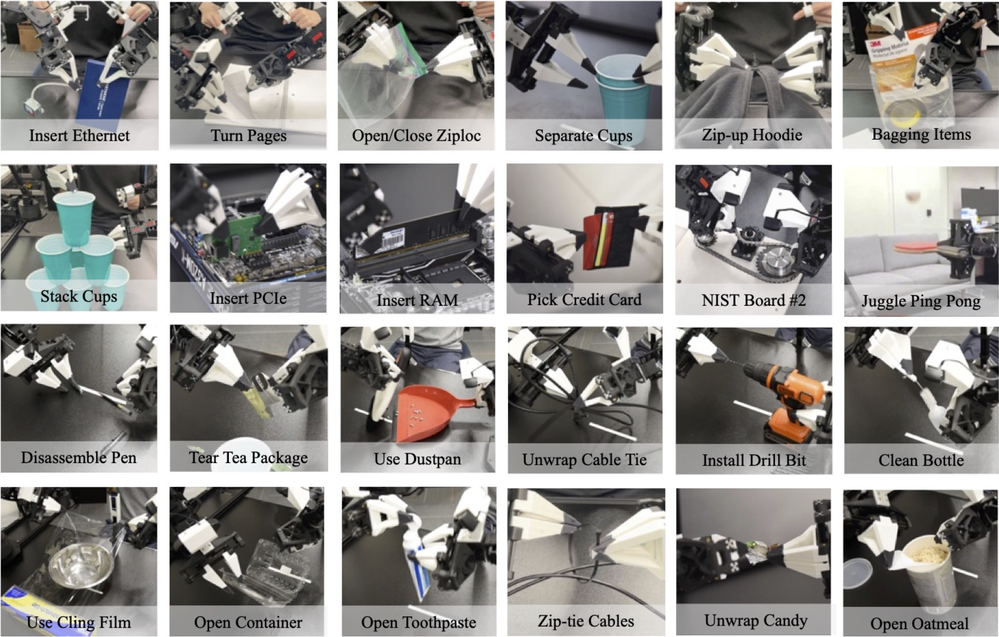
<!-- Fig. 9: Teleoperation task examples with ALOHA. We include videos on the [project website](https://tonyzhaozh.github.io/aloha/). -->
图9: 使用ALOHA的远程操作任务示例。我们在[项目网站](https://tonyzhaozh.github.io/aloha/)上展示了视频。

## Example Image Observations
<!-- We include example image observations taken during policy execution time in Figure 10, for each of the 6 real tasks. From left to right, the 4 images are from top camera, front camera, left wrist, and right wrist respectively. The top and front cameras are static, while the wrist cameras move with the robots and give detailed views of the gripper. We also rotate the front camera by 90 degrees to capture more vertical space. For all cameras, the focal length is fixed with auto-exposure on to adjust for changing lighting conditions. All cameras steam at $480 \times 640$ and 30fps. -->
我们在[图10](#fig.10)中包含了(6个现实任务中的每一个)在策略执行期间拍摄的示例图像观察。
从左到右, 4个图像分别来自顶部摄像头、前置摄像头、左手腕和右手腕。
顶部和前置摄像头是静态的, 而腕部摄像头则随机器人移动, 并提供夹具的详细视图。
我们还将前置摄像头旋转90度, 以捕捉更多的垂直空间。
对于所有相机, 焦距是固定的, 并且自动曝光打开, 以适应不断变化的照明条件。
所有相机运行在$480 \times 640$和30fps。

## Detailed Architecture Diagram
<!-- We include a more detailed architecture diagram in [Figure 11](#fig.11). At training time, we first sample tuples of RGB images and joint positions, together with the corresponding action sequence as prediction target (Step 1: sample data). We then infer style variable $z$ using CVAE encoder shown in yellow (Step 2: infer $z$). The input to the encoder are 1) the [CLS] token, which consists of learned weights that are randomly initialized, 2) embedded joint positions, which are joint positions projected to the embedding dimension using a linear layer, 3) embedded action sequence, which is the action sequence projected to the embedding dimension using another linear layer. These inputs form a sequence of $(k + 2) \times \mathit{embedding\_dimension}$, and is processed with the transformer encoder. We only take the first output, which corresponds to the [CLS] token, and use another linear network to predict the mean and variance of $z$'s distribution, parameterizing it as a diagonal Gaussian. A sample of $z$ is obtained using reparameterization, a standard way to allow back-propagating through the sampling process so the encoder and decoder can be jointly optimized [33]. -->
我们在[图 11](#fig.11)中包含了更详细的架构图。
在训练时, 我们首先对 RGB 图像和关节位置的元组进行采样, 并将相应的动作序列作为预测目标(步骤1: 采样数据)。
然后, 我们使用黄色区域的CVAE编码器, 推理style变量$z$(步骤2: 推理$z$)。
编码器的输入包括: 
1) [CLS]词元, 由随机初始化的学习权重组成, 
2) 嵌入关节位置, 它使用线性层将关节位置投影到嵌入维度, 
3) 嵌入动作序列, 这使用另一个线性层将动作序列投影到嵌入维度。

这些输入形成一个$(k + 2) \times \mathit{embedding\_dimension}$的序列, 并使用Transformer编码器进行处理。
我们只取(对应于[CLS]词元的)第一个输出, 并使用另一个线性网络来预测$z$分布的均值和方差, 将其参数化为对角高斯分布。
使用重新参数化获得$z$的样本, 重新参数化是一种通过采样过程进行反向传播的标准方法, 因此可以联合优化编码器和解码器[33]。

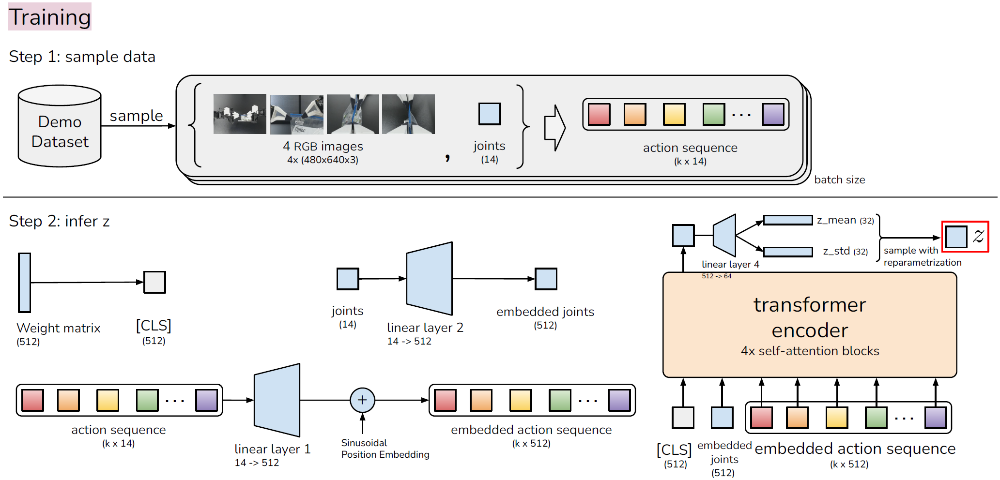

<!-- Next, we try to obtain the predicted action from CVAE decoder i.e. the policy (Step 3: predict action sequence). For each of the image observations, it is first processed by a ResNet18 to obtain a feature map, and then flattened to get a sequence of features. These features are projected to the embedding dimension with a linear layer, and we add a 2D sinusoidal position embedding to perserve the spatial information. The feature sequence from each camera is then concatenated to be used as input to the transformer encoder. Two additional inputs are joint positions and $z$, which are also projected to the embedding dimension with two linear layers respectively. The output of the transformer encoder are then used as both "keys" and "values" in cross attention layers of the transformer decoder, which predicts action sequence given encoder output. The "queries" are fixed sinusoidal embeddings for the first layer. -->
接下来, 我们尝试从CVAE解码器(即策略)获取预测动作(步骤3: 预测动作序列)。
对于每个图像观测, 首先用ResNet18进行处理, 以获得特征图, 然后展平以获得特征序列。
通过线性层将这些特征投影到嵌入维度, 并且我们添加一个2D正弦位置嵌入, 以保留空间信息。
然后, 将每个摄像机的特征序列连接起来, 用作transformer编码器的输入。
两个额外的输入是关节位置和$z$, 分别用两个线性层将它们投影到嵌入维度。
然后, transformer编码器的输出被用作transformer解码器的交叉关注层中的"键"和"值", 该解码器根据给定的编码器输出来预测动作序列。
"查询"是第一层的固定正弦嵌入。

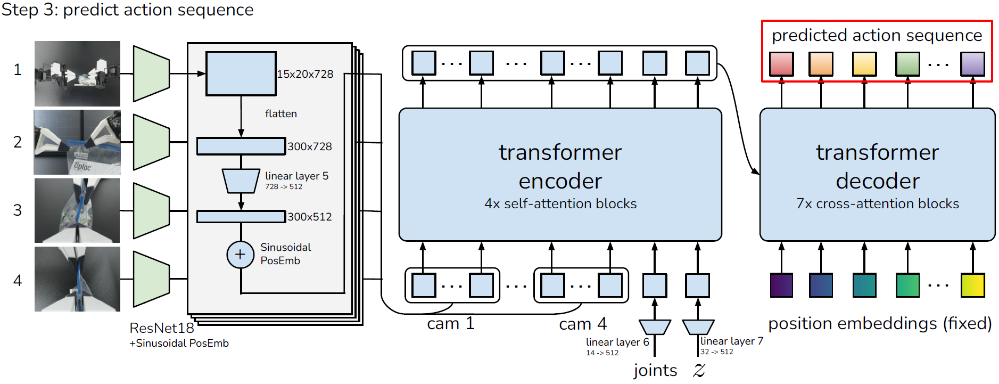

<!-- At test time, the CVAE encoder (shown in yellow) is discarded and the CVAE decoder is used as the policy. The incoming observations (images and joints) are fed into the model in the same way as during training. The only difference is in $z$, which represents the "style" of the action sequence we want to elicit from the policy. We simply set $z$ to a zero vector, which is the mean of the unit Gaussian prior used during training. Thus given an observation, the output of the policy is always deterministic, benefiting policy evaluation. -->
在测试时, CVAE编码器(以黄色显示)被丢弃, 并CVAE解码器被用作策略。
传入的观察结果(图像和关节)以与训练期间相同的方式输入模型。
唯一的区别在于$z$, 它代表(我们想要从策略中抽出的)操作序列的"风格"。
我们只需将$z$设置为零向量, 它是训练期间使用的单位高斯先验的均值。
因此, 给定一个观察, 政策的输出始终是确定性的, 有利于政策评估。

<span id='fig.11'></span>
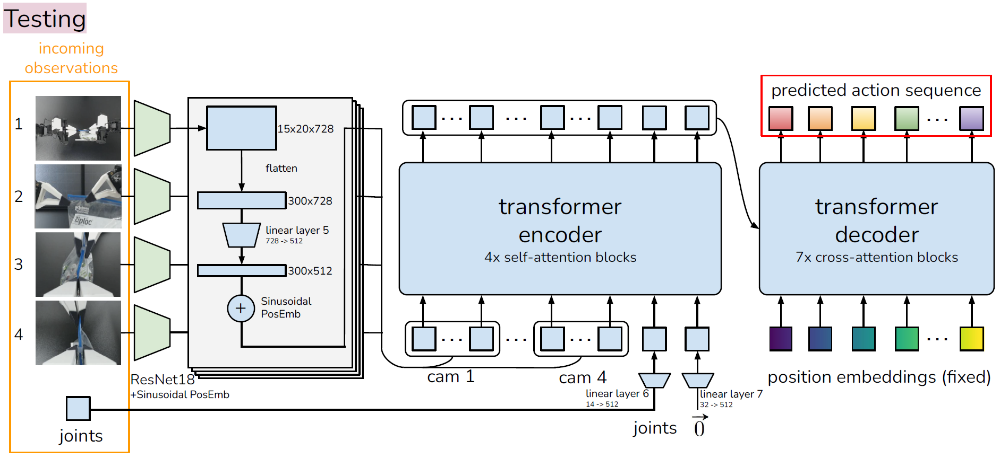
<!-- Fig. 11: Detail architecture of Action Chunking with Transformers (ACT). -->
图11: Action Chunking with Transformers (ACT)的详细架构

## Experiment Details and Hyperparameters
<!-- We carefully tune the baselines and include the hyperparameters used in Table III, IV, V, VI, VII. For BeT, we found that increasing history length from 10 (as in original paper) to 100 greatly improves the performance. Large hidden dimension also generally helps. For VINN, the k used when retrieving nearest neighbor is adaptively chosen with the lowest validation loss, same as the original paper. We also found that using joint position differences in addition to visual feature similarity improves performance when there is no action chunking, in which case we have state weight = 10 when retrieving actions. However, we found this to hurt performance with action chunking and thus set state weight to 0 for action chunking experiments. -->
我们仔细调整基线, 并将使用的超参数列于表[III](#table.III)、[IV](#table.IV)、[V](#table.V)、[VI](#table.VI)、[VII](#table.VII)。
对于BeT, 我们发现将历史长度从10(如原文中所示)增加到100极大地提高了性能。
大的隐藏维数通常也有帮助。
对于VINN, 检索最近邻时使用的$k$, 根据最低的验证损失自适应选择, 与原始论文相同。
我们还发现, 在无action chunking的情况下, 除了视觉特征相似性之外, 使用关节位置差异可以提高性能, 在这种情况下, 在检索动作时我们令状态权重=10。
然而, 我们发现使用action chunking会损害性能, 因此对于action chunking实验, 将状态权重设置为0。

TABLE III:<span id='table.III'></span> Hyperparameters of ACT.
variable | value
:- | :-:
learning rate | 1e-5
batch size | 8
\# encoder layers | 4
\# decoder layers | 7
feedforward dimension | 3200
hidden dimension | 512
\# heads | 8
chunk size | 100
beta | 10
dropout | 0.1

TABLE IV:<span id='table.IV'></span> Hyperparameters of BYOL, the feature extractor for VINN and BeT.
variable | value
:- | :-:
learning rate | 3e-4
batch size | 128
epochs | 100
momentum | 0.9
weight decay | 1.5e-6

TABLE V:<span id='table.V'></span> Hyperparameters of BeT.
variable | value
:- | :-:
learning rate | 1e-4
batch size | 64
\# layers | 6
\# heads | 6
hidden dimension | 768
history length | 100
weight decay | 0.1
offset loss scale | 1000
focal loss gamma | 2
dropout | 0.1
discretizer \#bins | 64

TABLE VI:<span id='table.VI'></span> Hyperparameters of VINN.
variable | value
:- | :-:
k (nearest neighbour) | adaptive
state weight | 0 or 10

TABLE VII:<span id='table.VII'></span> Hyperparameters of RT-1.
variable | value
:- | :-:
learning rate | 1e-5
batch size | 2
ViT dim head | 32
ViT window size | 7
ViT mbconv expansion rate | 4
ViT mbconv shrinkage rate | 0.25
ViT dropout | 0.1
RT-1 depth | 6
RT-1 heads | 8
RT-1 dim head | 64
RT-1 action bins | 256
RT-1 cond drop prob | 0.2
RT-1 token learner num output tokens | 8
weight decay | 0
history length | 6

## User Study Details
<!-- We conduct the user study with 6 participants, recruited from computer science graduate students, with 4 men and 2 women aged 22-25. 3 of the participants had experience teleoperating robots with a VR controller, and the other 3 has no prior experience teleoperating. None of the participants used ALOHA before. To implement the 5Hz version of ALOHA, we read from the leader robot at 5Hz, interpolate in the joint space, and send the interpolated positions to the robot at 50Hz. We choose tasks that emphasizes high-precision and close-loop visual feedback. We include images of the objects used in Figure 12. For threading zip cable tie, the hole measures 4mm x 1.5mm, and the cable tie measures 0.8mm x 3.5mm with a pointy tip. It is initially lying flat on the table, and the operator needs to pick it up with one gripper, grasp the other end midair, then coordinate both hands to insert one end of the cable tie into the hole on the other end. For unstacking cup, we use two single-use plastic cups that has 2.5mm clearance between them when stacked. The teleoperator need to grasp the edge of upper cup, then either shake to separate or use the help from the other gripper. During the user study, we randomize the order in which operators attempt each task, and whether they use 50Hz or 5Hz controller first. We also randomize the initial position of the object randomly around the table center. For each setting, the operator has 2 minutes to adapt, followed by 3 consecutive attempts of the task with duration recorded. -->
我们邀请6名参与者进行用户研究, 从计算机科学研究生中招募, 其中4名男性和2名女性, 年龄在22-25岁之间。
其中3名参与者有过(使用VR控制器)远程操作机器人的经验, 另外3名参与者之前没有远程操作经验。
没有参与者之前使用过ALOHA。
为了实施ALOHA的5Hz版本, 我们以5Hz的频率从leader机器人读取数据, 在关节空间进行插值, 然后以50Hz的频率将插值后的位置发送给机器人。
我们选择强调高精度和闭环视觉反馈的任务。
我们在[图12](#fig.12)中展示了使用对象的图像。
对于穿扎带, 孔洞的尺寸为4mm x 1.5mm, 扎带尺寸为0.8mm x 3.5mm, 带有尖头。
它最初平放在桌子上, 操作员需要用一个夹具将其拿起, 在半空中抓住另一端, 然后协调双手将扎带的一端插入另一端的孔洞中。
对于分开杯子, 我们使用两个一次性塑料杯, 堆叠时它们之间有2.5mm的间隙。
远程操作员需要抓住上面杯子的边缘, 然后摇晃分开或借助另一个夹具。
在用户研究期间, 我们随机化(操作员尝试每项任务的)顺序, 以及他们先使用50Hz还是5Hz控制器。
我们还以桌子中心, 随机化物体的初始位置。
对于每个配置, 操作员有2分钟的时间进行适应, 然后连续尝试3次任务, 并记录持续时间。

<span id='fig.12'></span>
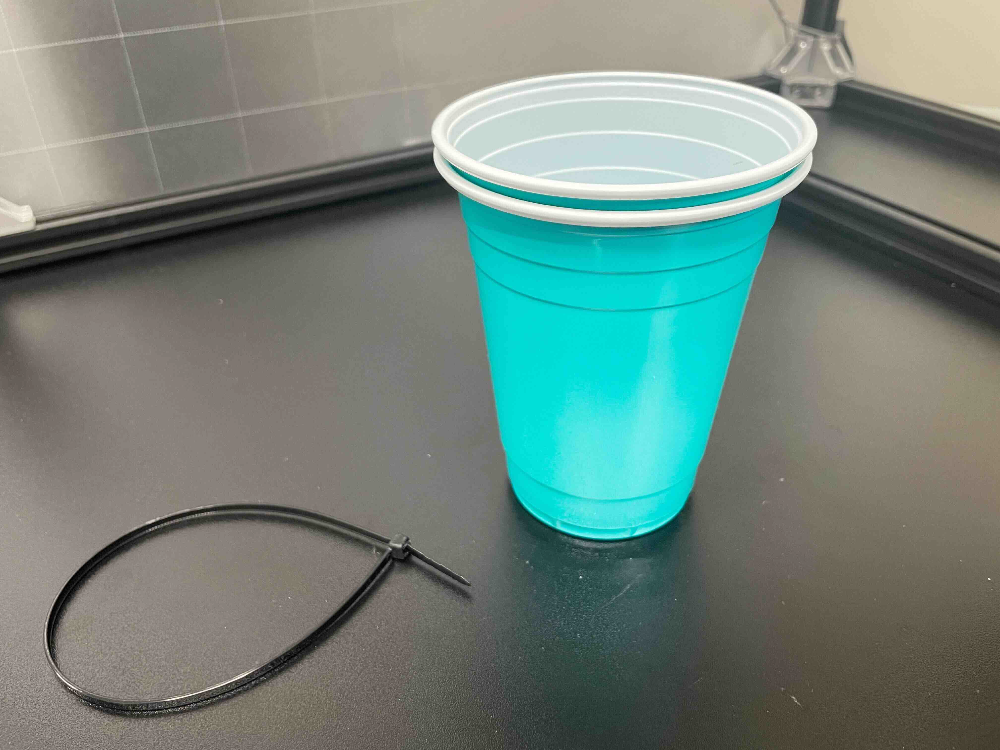
<!-- Fig. 12: The cable tie and cups for user study. -->
图12: 用于用户研究的扎带和杯子。

## Limitations
<!-- We now discuss limitations of the ALOHA hardware and the policy learning with ACT. -->
我们现在讨论ALOHA硬件以及ACT的策略学习的局限性。

<!-- **Hardware Limitations**. On the hardware front, ALOHA struggles with tasks that require multiple fingers from both hands, for example opening child-proof pill bottles with a push tab. To open the bottle, one hand needs to hold the bottle and pushes down on the push tab, with the other hand twisting the lid open. ALOHA also struggles with tasks that require high amount of forces, for example lifting heavy objects, twisting open a sealed bottle of water, or opening markers caps that are tightly pressed together. This is because the low-cost motors cannot generate enough torque to support these manipulations. Tasks that requires finger nails are also difficult for ALOHA, even though we design the grippers to be thin on the edge. For example, we are not able to lift the edge of packing tape when it is taped onto itself, or opening aluminum soda cans. -->
**硬件局限性**。
在硬件方面, ALOHA很难完成需要双手多根手指的任务, 例如用推片打开儿童安全药瓶。
为了打开瓶子, 需要一只手握住瓶子并向下推推片, 另一只手拧开盖子。
ALOHA也难以完成需要高强度力量的任务, 例如举起重物、拧开密封的水瓶或打开紧紧压在一起的记号笔帽。
这是因为低成本电机无法产生足够的扭矩来支持这些操作。
尽管我们将夹具设计得边缘较薄, 但对于ALOHA, 需要指甲完成的任务也很困难。
例如, 当包装胶带粘在自身上时, 我们无法抬起包装胶带的边缘, 或者打开铝制易拉罐。

<!-- **Policy Learning Limitations**. On the software front, we report all 2 tasks that we attempted where ACT failed to learn the behavior. The first one is unwrapping candies. The steps involves picking up the candy from the table, pull on both ends of it, and pry open the wrapper to expose the candy. We collected 50 demonstrations to train the ACT policy. In our preliminary evaluation with 10 trials, the policy picks up the candy 10/10, pulls on both ends 8/10, while unwraps the candy 0/10. We attribute the failure to the difficulty of perception and lack of data. Specifically, after pulling the candy on both sides, the seam for prying open the candy wrapper could appear anywhere around the candy. During demonstration collection, it is difficult even for human to discern. The operator needs to judge by looking at the graphics printed on the wrapper and find the discontinuity. We constantly observe the policy trying to peel at places where the seam does not exist. To better track the progress, we attempted another evaluation where we give 10 trials for each candy, and repeat this for 5 candies. For this protocol, our policy successfully unwraps 3/5 candies. -->
**策略学习局限性**。
在软件方面, 我们报告了我们尝试过的2个任务, 在这些任务中ACT无法学会行为。
第一个是拆糖果。
步骤包括从桌子上拿起糖果, 拉动两端, 然后撬开包装纸, 露出糖果。
我们收集了50个演示以训练ACT策略。
在我们用10次试验的初步评估中, 策略拾起糖果10/10, 拉动两端8/10, 然而打开糖果0/10。
我们将失败归因于感知困难和数据缺乏。
具体来说, 将糖果从两侧拉开后, 用于撬开糖果包装纸的缝隙可能会出现在(糖果周围的)任何地方。
在演示收集期间, 即使人类也很难辨别。
操作人员需要通过查看包装纸上印刷的图形来判断, 找到不连续的地方。
我们经常观察到, 策略试图(在缝隙不存在的地方)剥离。
为了更好地跟踪进度, 我们尝试了另一项评估, 对每种糖果进行10次试验, 并对5种糖果重复此操作。
对于此协定, 我们的策略成功打开了3/5糖果。

<!-- Another task that ACT struggles with is opening a small ziploc bag laying flat on the table. The right gripper needs to first pick it up, adjust it so that the left gripper can grasp firmly on the pulling region, followed by the right hand grasping the other side of the pulling region, and pull it open. Our policy trained with 50 demonstrations can consistently pick up the bag, while having difficulties performing the following 3 mid-air manipulation steps. We hypothesize that the bag is hard to perceive, and in addition, small differences in the pick up position can affect how the bag deforms, and result in large differences in where the pulling region ends up. We believe that pretraining, more data, and better perception are promising directions to tackle these extremely difficult tasks. -->
ACT难以应对的另一项任务是打开一个平放在桌子上的小密封袋。
右夹具先将其拾起, 调整至左夹具能牢牢抓住拉动区域, 然后用右手抓住拉动区域的另一侧, 将其拉开。
我们的策略经过50次演示训练, 可以一贯地捡起袋子, 但在执行接下来的三个半空中操作步骤时遇到困难。
我们假设袋子很难被感知, 此外, 拾取位置的微小差异会影响袋子如何变形, 导致拉动区域结束的地方存在较大差异。
我们相信预训练、更多数据和更好的感知是(解决这些极其困难的任务的)有希望的方向。